# Проект создания модели поиска фото по описанию для сервиса *“With Sense”*

## Цели исследования

- Разработка демонстрационной версии модели для поиска изображений по запросу.

- Оценка потенциала от внедрения модели в сервис.

## Ход исследования

- Загрузка и объединение текстовой составляющей данных.


- Загрузка и ознакомление с фото-составляющей датасета.


- Создание эмбеддингов с участием BERT-модели.


- Векторизация графической части.


- Конкатенация преобразованных данных.


- Обучение и тестирования разных типов моделей и оценка эффективности.


- Финальный вывод и рекомендации на основании полученных результатов.


## Описание данных

**train_dataset.csv**
- **image** - имя файла изображения (например, `000001.jpg`)
- **query_id** - уникальный идентификатор описания (формат: `<имя файла>#<номер>`, например `000001.jpg#1`)
- **query_text** - текстовое описание изображения

**CrowdAnnotations.tsv** - краудсорсинговые оценки соответствия
1. **image** - имя файла изображения
2. **query_id** - идентификатор описания
3. **agreement_rate** - доля людей, подтвердивших соответствие описания изображению (от 0 до 1)
4. **positive_count** - количество человек, подтвердивших соответствие
5. **negative_count** - количество человек, отвергнувших соответствие

**ExpertAnnotations.tsv** - экспертные оценки соответствия
1. **image** - имя файла изображения
2. **query_id** - идентификатор описания
3. **expert1_score** - оценка первого эксперта (шкала 1-4)
4. **expert2_score** - оценка второго эксперта (шкала 1-4)
5. **expert3_score** - оценка третьего эксперта (шкала 1-4)

**Шкала экспертных оценок:**
- **1** - изображение и запрос совершенно не соответствуют
- **2** - запрос содержит элементы описания, но в целом не соответствует
- **3** - запрос и текст соответствуют с некоторыми неточностями
- **4** - полное соответствие запроса и текста

**test_queries.csv** - тестовые данные для оценки модели
- **query_id** - идентификатор запроса (формат: `<имя файла>#<номер>`)
- **query_text** - текстовый запросa
- **relevant_image** - имя файла релевантного изображения

📁 **test_images/** - папка с тестовыми изображениями
- Содержит файлы изображений для тестирования модели

📁 **train_images/** - папка с обучающими изображениями
- Содержит файлы изображений, упомянутые в `train_dataset.csv`

## Техническая секция

### Импорты библиотек

In [ ]:
import random
import copy
import time
from pathlib import Path


# Предупреждения
import warnings

# Системные операции
import os
import re
import time
import random
import pickle
import joblib

# Манипуляции с данными
import pandas as pd
import numpy as np

# Визуализация
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.ticker as ticker
import matplotlib.image as mpimg
import seaborn as sns

# Прогресс бар
from tqdm import tqdm
import tqdm as notebook_tqdm

# NLP и обработка текста
import spacy
from sklearn.feature_extraction.text import TfidfVectorizer
from transformers import (
    AutoTokenizer,
    AutoModelForSequenceClassification,
    AutoModel,
    CLIPProcessor,
    CLIPModel
)

# Машинное обучение
from sklearn.compose import ColumnTransformer, make_column_selector
from sklearn.preprocessing import FunctionTransformer
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.linear_model import LogisticRegression, LinearRegression, SGDRegressor
from sklearn.svm import LinearSVC
from sklearn.model_selection import (
    train_test_split,
    GridSearchCV,
    cross_val_score,
    cross_validate,
    GroupShuffleSplit,
    StratifiedKFold,
    GroupKFold
)
from sklearn.metrics import (
    confusion_matrix,
    f1_score,
    accuracy_score,
    classification_report,
    roc_auc_score,
    mean_squared_error,
    r2_score,
    mean_absolute_error
    )
from sklearn.pipeline import Pipeline

# Градиентный бустинг
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier

# EDA и анализ данных
from ydata_profiling import ProfileReport

# PyTorch - общие
import torch
import torch.nn as nn
import torch.optim as optim

# PyTorch - работа с данными
from torch.utils.data import (
    Dataset,
    DataLoader,
    TensorDataset,
    random_split
)

# PyTorch - компьютерное зрение
from torchvision import (
    transforms,
    models
)
from PIL import Image

# PyTorch Vision модели
import torchvision.models as vision_models
from torchvision.models import ResNet50_Weights

# CLIP models
import clip


### Определение констант

In [ ]:
RS = 42
%matplotlib inline
warnings.filterwarnings("ignore", category=FutureWarning)
# warnings.filterwarnings("ignore", category=UserWarning)


### Кастомные функции

In [ ]:
# Английские паттерны для поиска упоминаний детей
child_patterns = [
        # Основные слова
        r'\bchild\b', r'\bchildren\b', r'\bboy\b', r'\bgirl\b',
        r'\bbaby\b', r'\bbabies\b', r'\binfant\b', r'\btoddler\b',
        r'\bkid\b', r'\bkids\b', r'\bson\b', r'\bdaughter\b',
        r'\bteenager\b', r'\bteen\b', r'\byouth\b', r'\bjunior\b',
        r'\bminor\b', r'\bjuvenile\b',

        # Возрастные указания
        r'\byoung\b.*\bboy\b', r'\byoung\b.*\bgirl\b',
        r'\byoung\b.*\bchild\b', r'\byoung\b.*\bchildren\b',

        # Альтернативные и сленговые обозначения
        r'\blad\b', r'\blass\b', r'\blassie\b', r'\bnipper\b',
        r'\btot\b', r'\bpupil\b', r'\byoungster\b',
        r'\bnewborn\b', r'\bneonate\b', r'\bpreteen\b',
        r'\btween\b', r'\badolescent\b', r'\bunderage\b',

        # Школьные и образовательные контексты
        r'\bschoolchild\b', r'\bschoolboy\b', r'\bschoolgirl\b',
        r'\bpreschooler\b', r'\belementary\b.*\bstudent\b',
        r'\bprimary\b.*\bstudent\b', r'\bmiddle\b.*\bstudent\b',

        # Возраст с цифрами
        r'\b\d+\s*(year|years)\s*old\b',
        r'\b\d+\s*y\.?o\.?\b',
        r'\bage\s*\d+\b',
        r'\b\d+\s*(month|months)\s*old\b',
        r'\b\d+\s*(week|weeks)\s*old\b',
        r'\b\d+\s*(day|days)\s*old\b',

        # Возрастные диапазоны
        r'\b\d+[-]\d+\s*(year|years)\s*old\b',
        r'\bage\s*\d+\s*to\s*\d+\b',
        r'\b\d+\s*to\s*\d+\s*years?\s*old\b',

        # Семейные отношения с указанием молодости
        r'\byoung\s*(son|daughter|brother|sister|child|children)\b',
        r'\blittle\s*(boy|girl|kid|kids|child|children)\b',
        r'\bsmall\s*(boy|girl|kid|kids|child|children)\b',

        # Школьные учреждения
        r'\b(elementary|primary|middle|high)\s*school\b',
        r'\bkindergarten\b', r'\bpreschool\b',
        r'\bnursery\s*school\b',

        # Детские товары и контексты
        r'\b(children|kids|child)\'?s\b',
        r'\bfor\s*(kids|children|babies|toddlers)\b',
        r'\b(child|children|kid|kids)\s*friendly\b',

        # Развивающие активности
        r'\b(playgroup|play\s*school|daycare)\b',
        r'\b(child|children|kids)\s*play\b',
        r'\b(children|kids)\s*activities\b',

        # Медицинские контексты
        r'\bpediatric\b', r'\bpaediatric\b',
        r'\bwell[-\s]*baby\b', r'\bchild\s*health\b',

        # Сленг и неформальные обозначения
        r'\b(munchkin|kiddo|tyke|rugrat|ankle-biter)\b',
        r'\b(little\s*one|young\s*one)\b',

        # Гендерно-нейтральные обозначения
        r'\b(child|kid|teen)\s*aged\s*\d+\b',
        r'\bminor\s*aged\s*\d+\b',

        # Возрастные категории
        r'\b(infant|toddler|preschooler|schoolager|adolescent)\b',
        r'\b(pre[-\s]*school|school[-\s]*age|teenage)\b',

        # Прилагательные, описывающие детей
        r'\b(younger|youngest|smaller|smallest)\s*(child|kid|brother|sister)\b',
    ]


In [ ]:
def remove_child_with_stats(df, treshhold=0.4):

    combined_pattern = re.compile('|'.join(child_patterns), re.IGNORECASE)

    total_images = df['image'].nunique()
    child_captions = df[df['query_text'].str.contains(combined_pattern, na=False)]
    child_images = child_captions[child_captions['agg_score'] > treshhold]['image'].unique()

    print(f"Всего изображений: {total_images}")
    print(f"Изображений с детьми в описаниях: {len(child_images)}")
    print(f"Процент удаляемых: {len(child_images)/total_images*100:.1f}%")

    df_clean = df[~df['image'].isin(child_images)]

    print(f"\nОсталось изображений: {df_clean['image'].nunique()}")

    return df_clean


In [ ]:
def find_top_images_clip(text_description, model, preprocess, image_dir,
                         top_k=5, device='cuda', show_images=True,
                         figsize=(20, 4), child_patterns=None,
                         enable_content_filter=True):
    """
    Находит и выводит top-K изображений с наибольшим соответствием текстовому описанию
    используя CLIP модель.

    Parameters:
    -----------
    text_description : str or list
        Текстовое описание для поиска или список описаний
    model : CLIP model
        Предобученная CLIP модель
    preprocess : torchvision.transforms
        Препроцессинг для изображений CLIP
    image_dir : str or Path
        Путь к директории с изображениями
    top_k : int, default=5
        Количество лучших результатов для возврата
    device : str
        Устройство для вычислений ('cuda' или 'cpu')
    show_images : bool
        Показывать ли изображения (True) или только вернуть результаты (False)
    figsize : tuple
        Размер фигуры для отображения (ширина, высота на одно изображение)
    child_patterns : list, optional
        Список паттернов для блокировки запрещенных слов
    enable_content_filter : bool, default=True
        Включить/выключить проверку на запрещенные слова

    Returns:
    --------
    results : list of dict or dict of lists
        Если передана одна фраза - список словарей с результатами.
        Если передан список фраз - словарь, где ключи - фразы, значения - списки результатов
    """

    # Паттерн для запрещенных слов
    combined_pattern = None
    if enable_content_filter and child_patterns:
        combined_pattern = re.compile('|'.join(child_patterns), re.IGNORECASE)

    # Загружаем список изображений из директории
    image_dir = Path(image_dir)
    if not image_dir.is_dir():
        raise ValueError(f"Директория не найдена: {image_dir}")

    image_extensions = {'.jpg', '.jpeg', '.png', '.gif', '.bmp', '.tiff'}
    image_paths = sorted([
        str(f) for f in image_dir.iterdir()
        if f.suffix.lower() in image_extensions
    ])

    if len(image_paths) == 0:
        raise ValueError(f"В директории {image_dir} не найдено изображений")

    print(f"Загружено {len(image_paths)} изображений из директории")
    if enable_content_filter and child_patterns:
        print(f"Фильтр контента: ВКЛЮЧЕН ({len(child_patterns)} паттернов)")
    else:
        print(f"Фильтр контента: ВЫКЛЮЧЕН")

    # Если передан список фраз
    if isinstance(text_description, list):
        print(f"Обработка {len(text_description)} фраз...\n")
        all_results = {}

        for i, phrase in enumerate(text_description, 1):
            print(f"\n{'='*80}")
            print(f"Фраза {i}/{len(text_description)}")
            print(f"{'='*80}")
            print(f"Запрос: '{phrase}'")

            # Проверка на запрещенные слова (только если фильтр включен)
            if combined_pattern and combined_pattern.search(phrase):
                print("This image is unavailable in your country in compliance with local laws.")
                all_results[phrase] = None
                continue

            # Обработка одной фразы
            results = _process_single_query_clip(
                phrase, model, preprocess, image_paths,
                top_k, device, show_images, figsize
            )
            all_results[phrase] = results

        print(f"\n{'='*80}")
        print(f"Обработка завершена. Всего фраз: {len(text_description)}")
        print(f"Успешно обработано: {sum(1 for v in all_results.values() if v is not None)}")
        print(f"Заблокировано: {sum(1 for v in all_results.values() if v is None)}")
        print(f"{'='*80}")

        return all_results

    # Если передана одна фраза (строка)
    else:
        # Проверка на запрещенные слова (только если фильтр включен)
        if combined_pattern and combined_pattern.search(text_description):
            print("This image is unavailable in your country in compliance with local laws.")
            return None

        return _process_single_query_clip(
            text_description, model, preprocess, image_paths,
            top_k, device, show_images, figsize
        )


def _process_single_query_clip(text_description, model, preprocess,
                               image_paths, top_k, device,
                               show_images, figsize):
    """
    Вспомогательная функция для обработки одного запроса с CLIP
    """

    # Энкодинг текста
    with torch.no_grad():
        text_tokens = clip.tokenize([text_description]).to(device)
        text_features = model.encode_text(text_tokens)
        text_features = text_features / text_features.norm(dim=-1, keepdim=True)

    # Энкодинг изображений
    image_features_list = []
    valid_image_paths = []

    print(f"Обработка {len(image_paths)} изображений...")

    for img_path in image_paths:
        try:
            image = preprocess(Image.open(img_path)).unsqueeze(0).to(device)

            with torch.no_grad():
                image_features = model.encode_image(image)
                image_features = image_features / image_features.norm(dim=-1, keepdim=True)

            image_features_list.append(image_features.cpu().numpy()[0])
            valid_image_paths.append(img_path)

        except Exception as e:
            print(f"Ошибка при обработке {img_path}: {e}")
            continue

    if len(image_features_list) == 0:
        raise ValueError("Не удалось обработать ни одного изображения")

    # Вычисляем косинусное сходство между текстом и всеми изображениями
    image_features_array = np.array(image_features_list)
    text_features_np = text_features.cpu().numpy()[0]

    # Косинусное сходство (так как векторы нормализованы, это просто скалярное произведение)
    similarities = np.dot(image_features_array, text_features_np)

    # Находим top-K индексов
    top_k = min(top_k, len(similarities))  # На случай если изображений меньше чем top_k
    top_indices = np.argsort(similarities)[-top_k:][::-1]

    # Формируем результаты
    results = []
    for rank, idx in enumerate(top_indices, 1):
        result = {
            'rank': rank,
            'index': int(idx),
            'similarity': float(similarities[idx]),
            'image_path': valid_image_paths[idx]
        }
        results.append(result)

    # Вывод результатов
    print(f"\nПоиск по запросу: '{text_description}'")
    print(f"\nНайдено топ-{top_k} изображений:\n")

    for res in results:
        print(f"{res['rank']}. Индекс: {res['index']}, "
              f"Сходство: {res['similarity']:.4f}, "
              f"Путь: {res['image_path']}")

    # Визуализация изображений
    if show_images:
        fig, axes = plt.subplots(1, top_k, figsize=figsize)

        # Если только одно изображение, axes не будет списком
        if top_k == 1:
            axes = [axes]

        for ax, res in zip(axes, results):
            try:
                img = Image.open(res['image_path'])
                ax.imshow(img)
                ax.axis('off')
                ax.set_title(f"#{res['rank']}: {res['similarity']:.3f}",
                           fontsize=12, pad=5)
            except Exception as e:
                ax.text(0.5, 0.5, f"Ошибка\nзагрузки",
                       ha='center', va='center', transform=ax.transAxes)
                ax.axis('off')

        plt.tight_layout()
        plt.show()

    return results

In [ ]:
def analyze_dataset_sizes(dataset_path):
    """Анализ размеров изображений в датасете"""
    sizes = []

    image_paths = []
    for root, dirs, files in os.walk(dataset_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_paths.append(os.path.join(root, file))

    print(f"Найдено изображений: {len(image_paths)}")

    for img_path in tqdm(image_paths, desc="Анализ изображений", unit="img"):
        try:
            with Image.open(img_path) as img:
                sizes.append(img.size)
        except Exception as e:
            pass

    if sizes:
        sizes = np.array(sizes)
        print(f"Успешно обработано изображений: {len(sizes)}")
        print(f"Минимальный размер: {sizes.min(axis=0)}")
        print(f"Максимальный размер: {sizes.max(axis=0)}")
        print(f"Средний размер: {sizes.mean(axis=0).astype(int)}")
        print(f"Медианный размер: {np.median(sizes, axis=0).astype(int)}")
    else:
        print("Не удалось обработать ни одного изображения")

    return sizes



In [ ]:
def print_size_distribution(sizes, limit=100):
    """
    Вывод распределения изображений по размерам

    Parameters:
    -----------
    sizes : list of tuple or numpy array
        Список/массив кортежей (ширина, высота)
    limit : int, optional
        Количество отображаемых размеров (по умолчанию 100)
    """
    import numpy as np

    # Проверка и преобразование входных данных
    if hasattr(sizes, 'size'):
        # Для numpy массивов
        if sizes.size == 0:
            print("Нет данных для анализа")
            return
        total_images = len(sizes)
        # Преобразуем к списку для удобства
        sizes_list = [(w, h) for w, h in sizes]
    else:
        # Для обычных списков
        if not sizes or len(sizes) == 0:
            print("Нет данных для анализа")
            return
        total_images = len(sizes)
        sizes_list = sizes

    print("\n" + "="*60)
    print("РАСПРЕДЕЛЕНИЕ ПО РАЗМЕРАМ")
    print("="*60)

    # Подготовка данных
    size_counts = {}
    for width, height in sizes_list:
        size_key = f"{int(width)}×{int(height)}"
        size_counts[size_key] = size_counts.get(size_key, 0) + 1

    # Сортировка по количеству (по убыванию)
    sorted_sizes = sorted(size_counts.items(), key=lambda x: x[1], reverse=True)

    # Определение фактического количества для вывода
    display_limit = min(limit, len(sorted_sizes))

    # Вывод топ-N размеров
    print(f"\nТоп-{display_limit} самых частых размеров (всего уникальных: {len(sorted_sizes)}):")
    print("-" * 50)
    print(f"{'Размер':<15} {'Количество':<12} {'Процент':<10} {'Кумулятивно':<12}")
    print("-" * 50)

    cumulative_percentage = 0
    for i, (size, count) in enumerate(sorted_sizes[:display_limit]):
        percentage = (count / total_images) * 100
        cumulative_percentage += percentage

        # Отметка для часто встречающихся размеров
        marker = "🔥" if percentage > 10 else "⭐" if percentage > 5 else ""

        print(f"{size:<15} {count:<12} {percentage:>6.1f}% {cumulative_percentage:>10.1f}%  {marker}")

    # Статистика по группам
    print(f"\n📊 ГРУППИРОВКА ПО КАТЕГОРИЯМ:")
    print("-" * 40)

    # Более гибкие критерии для квадратных изображений
    square = sum(1 for w, h in sizes_list if 0.95 <= w/h <= 1.05)  # строгий квадрат
    square_approx = sum(1 for w, h in sizes_list if 0.9 <= w/h <= 1.1)  # приблизительный квадрат
    landscape = sum(1 for w, h in sizes_list if w/h > 1.1)  # альбомные
    portrait = sum(1 for w, h in sizes_list if w/h < 0.9)  # портретные

    print(f"   Квадратные (1:1 ±5%): {square:>5} ({square/total_images*100:>5.1f}%)")
    print(f"   Квадратные (1:1 ±10%): {square_approx:>4} ({square_approx/total_images*100:>5.1f}%)")
    print(f"   Альбомные (широкие): {landscape:>6} ({landscape/total_images*100:>5.1f}%)")
    print(f"   Портретные (высокие): {portrait:>5} ({portrait/total_images*100:>5.1f}%)")

    # Дополнительная статистика
    print(f"\n📈 СТАТИСТИКА:")
    print("-" * 40)

    if total_images > 0:
        # Безопасное вычисление средних значений
        widths = [w for w, h in sizes_list]
        heights = [h for w, h in sizes_list]
        ratios = [w/h for w, h in sizes_list if h != 0]  # избегаем деления на 0

        avg_width = sum(widths) / total_images
        avg_height = sum(heights) / total_images
        avg_ratio = sum(ratios) / len(ratios) if ratios else 0

        print(f"   Средняя ширина: {avg_width:.0f}px")
        print(f"   Средняя высота: {avg_height:.0f}px")
        print(f"   Среднее соотношение: {avg_ratio:.2f}:1")

        # Минимальные и максимальные значения
        min_width, min_height = min(widths), min(heights)
        max_width, max_height = max(widths), max(heights)

        print(f"   Мин. размер: {min_width}×{min_height}px")
        print(f"   Макс. размер: {max_width}×{max_height}px")

        # Самые частые разрешения
        print(f"\n🎯 САМЫЕ ЧАСТЫЕ РАЗРЕШЕНИЯ:")
        print("-" * 40)
        top_count = min(5, display_limit)
        for size, count in sorted_sizes[:top_count]:
            percentage = (count / total_images) * 100
            print(f"   {size}: {count} изображений ({percentage:.1f}%)")

    print("\n" + "="*60)




In [ ]:
def visualize_size_stats(sizes):
    """Визуализация статистики по размерам"""
    if len(sizes) == 0:
        return

    sizes_array = np.array(sizes)
    widths = sizes_array[:, 0]
    heights = sizes_array[:, 1]

    fig, axes = plt.subplots(2, 3, figsize=(15, 10))
    fig.suptitle('Статистика размеров изображений в датасете', fontsize=16)

    # 1. Гистограмма ширины
    axes[0, 0].hist(widths, bins=50, alpha=0.7, color='skyblue', edgecolor='black')
    axes[0, 0].set_title('Распределение ширины')
    axes[0, 0].set_xlabel('Ширина (px)')
    axes[0, 0].set_ylabel('Количество')
    axes[0, 0].grid(True, alpha=0.3)

    # 2. Гистограмма высоты
    axes[0, 1].hist(heights, bins=50, alpha=0.7, color='lightgreen', edgecolor='black')
    axes[0, 1].set_title('Распределение высоты')
    axes[0, 1].set_xlabel('Высота (px)')
    axes[0, 1].set_ylabel('Количество')
    axes[0, 1].grid(True, alpha=0.3)

    # 3. Scatter plot
    axes[0, 2].scatter(widths, heights, alpha=0.5, s=10, color='red')
    axes[0, 2].set_title('Соотношение ширина/высота')
    axes[0, 2].set_xlabel('Ширина (px)')
    axes[0, 2].set_ylabel('Высота (px)')
    axes[0, 2].grid(True, alpha=0.3)

    # 4. Box plot ширины
    axes[1, 0].boxplot(widths, vert=False)
    axes[1, 0].set_title('Box plot ширины')
    axes[1, 0].set_xlabel('Ширина (px)')
    axes[1, 0].grid(True, alpha=0.3)

    # 5. Box plot высоты
    axes[1, 1].boxplot(heights, vert=False)
    axes[1, 1].set_title('Box plot высоты')
    axes[1, 1].set_xlabel('Высота (px)')
    axes[1, 1].grid(True, alpha=0.3)

    # 6. Гистограмма соотношения сторон
    ratios = widths / heights
    axes[1, 2].hist(ratios, bins=50, alpha=0.7, color='purple', edgecolor='black')
    axes[1, 2].set_title('Распределение соотношения сторон')
    axes[1, 2].set_xlabel('Соотношение (ширина/высота)')
    axes[1, 2].set_ylabel('Количество')
    axes[1, 2].grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

## Загрузка и первичное ознакомление с  данными

Последовательно загрузим присланные нам датасеты для определения стратегии дальнейшего объединения нескольких наборов данных в один.

In [ ]:
DATA_PATH = r'C:\Jupi\vision'

In [ ]:
df_train = pd.read_csv(os.path.join(DATA_PATH, 'train_dataset.csv'))
df_train.head(15)

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
5,3030566410_393c36a6c5.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
6,3155451946_c0862c70cb.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
7,3222041930_f642f49d28.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
8,343218198_1ca90e0734.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
9,3718964174_cb2dc1615e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


In [ ]:
ProfileReport(df_train, title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 3/3 [00:00<00:00,  9.01it/s]


In [ ]:
df_ca = pd.read_csv(os.path.join(DATA_PATH,'CrowdAnnotations.tsv'), sep='\t', header=None) #CrowdAnnotations.tsv
df_ca.head(15)

,0,1,2,3,4
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.000000,3,0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.000000,0,3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.000000,0,3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.000000,0,3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.000000,0,3
5,1056338697_4f7d7ce270.jpg,2204550058_2707d92338.jpg#2,0.000000,0,3
6,1056338697_4f7d7ce270.jpg,2224450291_4c133fabe8.jpg#2,0.000000,0,3
7,1056338697_4f7d7ce270.jpg,2248487950_c62d0c81a9.jpg#2,0.333333,1,2
8,1056338697_4f7d7ce270.jpg,2307118114_c258e3a47e.jpg#2,0.000000,0,3
9,1056338697_4f7d7ce270.jpg,2309860995_c2e2a0feeb.jpg#2,0.000000,0,3


In [ ]:
ProfileReport(df_ca, title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 5/5 [00:00<00:00, 72.41it/s]


In [ ]:
df_ea = pd.read_csv(os.path.join(DATA_PATH,'ExpertAnnotations.tsv'), sep='\t', header=None) #ExpertAnnotations.tsv
df_ea.head(15)

,0,1,2,3,4
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2
5,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,1,1,1
6,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,1,1,1
7,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,1,1,2
8,106490881_5a2dd9b7bd.jpg,1425069308_488e5fcf9d.jpg#2,1,1,1
9,106490881_5a2dd9b7bd.jpg,1714316707_8bbaa2a2ba.jpg#2,2,2,2


In [ ]:
ProfileReport(df_ea, title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 5/5 [00:00<00:00, 142.80it/s]


**Загрузка тестового набора данных**

In [ ]:
df_test = pd.read_csv(os.path.join(DATA_PATH,'test_images.csv'))
df_test.head(15)

,image
0,3356748019_2251399314.jpg
1,2887171449_f54a2b9f39.jpg
2,3089107423_81a24eaf18.jpg
3,1429546659_44cb09cbe2.jpg
4,1177994172_10d143cb8d.jpg
5,424307754_1e2f44d265.jpg
6,3044359043_627488ddf0.jpg
7,3396275223_ee080df8b5.jpg
8,2977379863_2e8d7a104e.jpg
9,634891010_9fa189effb.jpg


In [ ]:
ProfileReport(df_test, title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 1/1 [00:00<00:00, 76.92it/s]


In [ ]:
df_test_que = pd.read_csv(os.path.join(DATA_PATH,'test_queries.csv'), sep='|')
df_test_que.head(15)

,Unnamed: 0,query_id,query_text,image
0,0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg
5,5,1232148178_4f45cc3284.jpg#0,A baby girl playing at a park .,1232148178_4f45cc3284.jpg
6,6,1232148178_4f45cc3284.jpg#1,A closeup of a child on a playground with adul...,1232148178_4f45cc3284.jpg
7,7,1232148178_4f45cc3284.jpg#2,A young boy poses for a picture in front of a ...,1232148178_4f45cc3284.jpg
8,8,1232148178_4f45cc3284.jpg#3,A young girl is smiling in front of the camera...,1232148178_4f45cc3284.jpg
9,9,1232148178_4f45cc3284.jpg#4,There is a little blond hair girl with a green...,1232148178_4f45cc3284.jpg


In [ ]:
ProfileReport(df_test_que, title="Profiling Report", minimal=False, progress_bar=False)

100%|██████████| 4/4 [00:00<00:00, 80.00it/s]


### Приведение названий колонок к единому стандарту.

In [ ]:
df_train.columns

Index(['image', 'query_id', 'query_text'], dtype='object')

In [ ]:
df_ca.columns = ['image', 'query_id', 'agreement_rate', 'positive_count', 'negative_count']

In [ ]:
df_ea.columns = ['image', 'query_id', 'expert1', 'expert2', 'expert3']

In [ ]:
display(df_train.columns)
display(df_ca.columns)
display(df_ea.columns)


Index(['image', 'query_id', 'query_text'], dtype='object')

Index(['image', 'query_id', 'agreement_rate', 'positive_count',
       'negative_count'],
      dtype='object')

Index(['image', 'query_id', 'expert1', 'expert2', 'expert3'], dtype='object')

### Ознакомление с графической состовляющей.

In [ ]:
path = './train_images'


In [ ]:
fotos_details = analyze_dataset_sizes(path)

Найдено изображений: 1000


Анализ изображений: 100%|██████████| 1000/1000 [00:00<00:00, 12984.70img/s]

Успешно обработано изображений: 1000
Минимальный размер: [200 166]
Максимальный размер: [500 500]
Средний размер: [455 398]
Медианный размер: [500 375]


In [ ]:
print_size_distribution(fotos_details, 10)


РАСПРЕДЕЛЕНИЕ ПО РАЗМЕРАМ

Топ-10 самых частых размеров (всего уникальных: 234):
--------------------------------------------------
Размер          Количество   Процент    Кумулятивно 
--------------------------------------------------
500×333         184            18.4%       18.4%  🔥
500×375         161            16.1%       34.5%  🔥
333×500         84              8.4%       42.9%  ⭐
500×334         52              5.2%       48.1%  ⭐
375×500         47              4.7%       52.8%  
500×332         27              2.7%       55.5%  
334×500         24              2.4%       57.9%  
500×335         20              2.0%       59.9%  
332×500         17              1.7%       61.6%  
500×400         16              1.6%       63.2%  

📊 ГРУППИРОВКА ПО КАТЕГОРИЯМ:
----------------------------------------
   Квадратные (1:1 ±5%):    31 (  3.1%)
   Квадратные (1:1 ±10%):   42 (  4.2%)
   Альбомные (широкие):    669 ( 66.9%)
   Портретные (высокие):   289 ( 28.9%)

📈 СТАТИСТИКА:
---

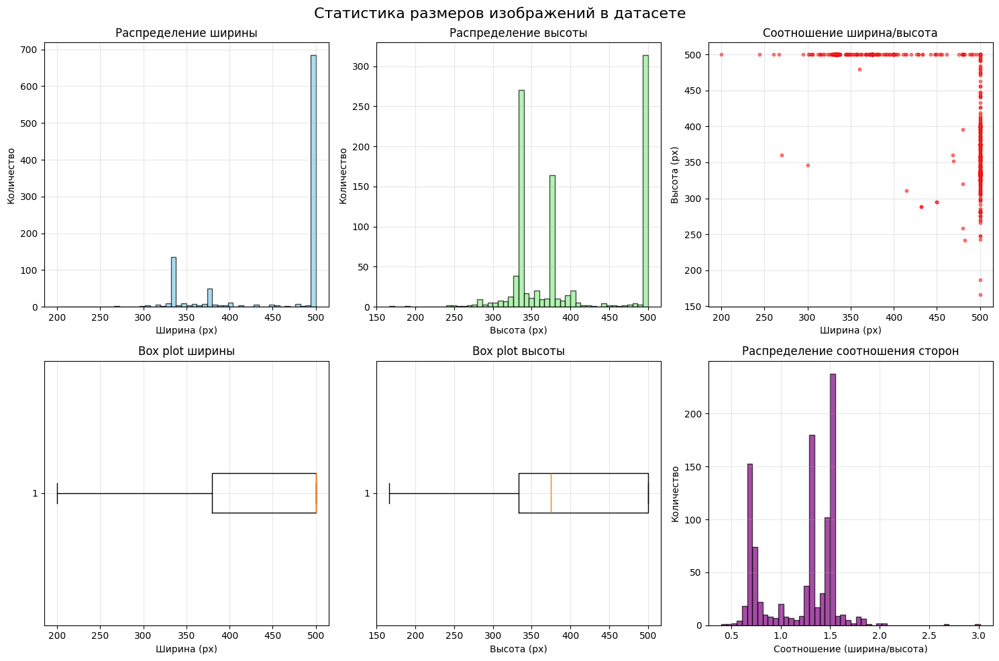

In [ ]:
visualize_size_stats(fotos_details)

In [ ]:
all_files = [f for f in os.listdir(path) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp'))]
files = random.sample(all_files, 15)


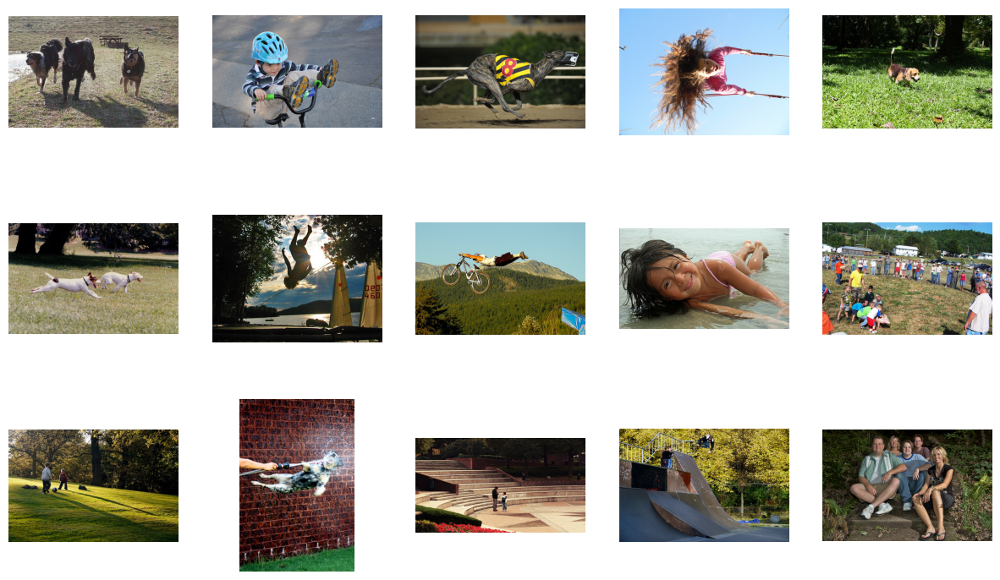

In [ ]:
n_cols = 5
n_rows = (len(files) + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 3*n_rows))
axes = axes.ravel()
for idx, file_name in enumerate(files):
    img_path = os.path.join(path, file_name)

    img = mpimg.imread(img_path)
    axes[idx].imshow(img)
    axes[idx].axis('off')

### Вывод:

- Мы загрузили о ознакомились с тренировочным и тестовым набором данных.


- Явных аномалий, пропусков и дефектов не нашлось.


- Графические данные так же не вызывают подозрений и готовы к обучению.


- Для дальнейшей простоты формирования единого датасета , привели названия колонок к единому стандарту.

## Подготовка обучающего датасета.

### Агрегация экспертных оценок

*Стандартизируем* экспертные оценки к диапазону 0-1.

In [ ]:
df_ea['escore'] = (df_ea[['expert1', 'expert2' , 'expert3']].mean(axis=1) - 1) / 3
df_ea.head(10)

,image,query_id,expert1,expert2,expert3,escore
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1,0.000000
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2,0.111111
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2,0.111111
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2,0.222222
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2,0.111111
5,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,1,1,1,0.000000
6,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,1,1,1,0.000000
7,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,1,1,2,0.111111
8,106490881_5a2dd9b7bd.jpg,1425069308_488e5fcf9d.jpg#2,1,1,1,0.000000
9,106490881_5a2dd9b7bd.jpg,1714316707_8bbaa2a2ba.jpg#2,2,2,2,0.333333


### Обьединение

Объединим датасеты с оценками и добавим к ним текстовое описание.

In [ ]:
df_outer = pd.merge(df_ca, df_ea, on=['image', 'query_id'], how='outer')
df_outer

,image,query_id,agreement_rate,positive_count,negative_count,expert1,expert2,expert3,escore
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.000000,3.0,0.0,NaN,NaN,NaN,NaN
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.000000,0.0,3.0,NaN,NaN,NaN,NaN
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.000000,0.0,3.0,NaN,NaN,NaN,NaN
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.000000,0.0,3.0,NaN,NaN,NaN,NaN
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.000000,0.0,3.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
51318,997722733_0cb5439472.jpg,543007912_23fc735b99.jpg#2,0.000000,0.0,3.0,NaN,NaN,NaN,NaN
51319,997722733_0cb5439472.jpg,544576742_283b65fa0d.jpg#2,0.333333,1.0,2.0,NaN,NaN,NaN,NaN
51320,997722733_0cb5439472.jpg,872622575_ba1d3632cc.jpg#2,1.000000,3.0,0.0,NaN,NaN,NaN,NaN
51321,997722733_0cb5439472.jpg,888425986_e4b6c12324.jpg#2,0.000000,0.0,3.0,NaN,NaN,NaN,NaN


In [ ]:
df_train_quer = df_train.drop_duplicates('query_id')[['query_id', 'query_text']]
df_train_quer

,query_id,query_text
0,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
12,2718495608_d8533e3ac5.jpg#2,A girl wearing a yellow shirt and sunglasses s...
22,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .
27,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...
31,3286822339_5535af6b93.jpg#2,Chinese market street in the winter time .
...,...,...
5817,2061144717_5b3a1864f0.jpg#2,A man in an ampitheater talking to a boy .
5818,2196107384_361d73a170.jpg#2,a old man walks down the uncrowded road .
5819,2112921744_92bf706805.jpg#2,A dog stands on the side of a grassy cliff .
5820,3651971126_309e6a5e22.jpg#2,A blurry photo of two dogs .


In [ ]:
df_outers = pd.merge(df_outer[['image', 'query_id', 'escore', 'agreement_rate']],
                    df_train_quer,
                    on=['query_id'],
                    how='left'

)
df_outers

,image,query_id,escore,agreement_rate,query_text
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,NaN,1.000000,"A woman is signaling is to traffic , as seen f..."
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,NaN,0.000000,A boy in glasses is wearing a red shirt .
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,NaN,0.000000,A young boy holds onto a blue handle on a pier .
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,NaN,0.000000,"A woman wearing black clothes , a purple scarf..."
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,NaN,0.000000,An older woman with blond hair rides a bicycle...
...,...,...,...,...,...
51318,997722733_0cb5439472.jpg,543007912_23fc735b99.jpg#2,NaN,0.000000,Two girls with orange shirts .
51319,997722733_0cb5439472.jpg,544576742_283b65fa0d.jpg#2,NaN,0.333333,A woman in jeans rock climbing .
51320,997722733_0cb5439472.jpg,872622575_ba1d3632cc.jpg#2,NaN,1.000000,A man is climbing the side of a mountain .
51321,997722733_0cb5439472.jpg,888425986_e4b6c12324.jpg#2,NaN,0.000000,A person flipping upside down


Проверим для всех ли *query_id* есть текстовое описание.

In [ ]:
df_outers.isna().sum()

image                 0
query_id              0
escore            45501
agreement_rate     3493
query_text         1109
dtype: int64

Удалим строки не умеющие текстового обозначения.

In [ ]:
df_outers.dropna(subset=['query_text'], inplace=True)

In [ ]:
df_outers.isna().sum()

image                 0
query_id              0
escore            44392
agreement_rate     3493
query_text            0
dtype: int64

Размерность итогового датасета составила 51,323 строк.

Введем общую оценку на основании имеющихся данных , по принципу если имеются обе оценки будем использовать их сумму с индексом 0.6 для экспертных и 0.4 для краудов , при ином сценарии будем использовать имеющеюся оценку.

In [ ]:
df_outers['agg_score'] = df_outers.apply(
    lambda row: (
        row['escore'] * 0.6 + row['agreement_rate'] * 0.4
        if pd.notna(row['escore']) and pd.notna(row['agreement_rate'])
        else row['escore'] if pd.notna(row['escore'])
        else row['agreement_rate'] if pd.notna(row['agreement_rate'])
        else np.nan
    ),
    axis=1
)

In [ ]:
df_outers.head(20)

,image,query_id,escore,agreement_rate,query_text,agg_score
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,NaN,1.000000,"A woman is signaling is to traffic , as seen f...",1.000000
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,NaN,0.000000,A boy in glasses is wearing a red shirt .,0.000000
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,NaN,0.000000,A young boy holds onto a blue handle on a pier .,0.000000
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,NaN,0.000000,"A woman wearing black clothes , a purple scarf...",0.000000
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,NaN,0.000000,An older woman with blond hair rides a bicycle...,0.000000
5,1056338697_4f7d7ce270.jpg,2204550058_2707d92338.jpg#2,NaN,0.000000,A woman wearing a white glove peers over the c...,0.000000
6,1056338697_4f7d7ce270.jpg,2224450291_4c133fabe8.jpg#2,NaN,0.000000,A man taking a picture with a silver camera .,0.000000
7,1056338697_4f7d7ce270.jpg,2248487950_c62d0c81a9.jpg#2,NaN,0.333333,"A woman crosses the street near a man , who is...",0.333333
8,1056338697_4f7d7ce270.jpg,2307118114_c258e3a47e.jpg#2,NaN,0.000000,A man wearing a black shirt and baseball cap s...,0.000000
9,1056338697_4f7d7ce270.jpg,2309860995_c2e2a0feeb.jpg#2,NaN,0.000000,A woman wears sunglasses and a black coat as s...,0.000000


Переведем наш непрерывный оценочный признак к бинарной структуре использовав порог 0.4 для присвоения класса 1.

In [ ]:
# threshold = 0.4

In [ ]:
# df_outers['bin_score'] = (df_outers['agg_score'] > threshold).astype('int')

In [ ]:
# df_outers

Избавимся от лишних колонок не участвующих в обучении.

In [ ]:
df_train_fin = df_outers.drop(['escore', 'agreement_rate'], axis=1)
df_train_fin = df_train_fin[['image', 'query_id', 'agg_score', 'query_text']]

In [ ]:
df_train_fin

,image,query_id,agg_score,query_text
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.000000,"A woman is signaling is to traffic , as seen f..."
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.000000,A boy in glasses is wearing a red shirt .
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.000000,A young boy holds onto a blue handle on a pier .
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.000000,"A woman wearing black clothes , a purple scarf..."
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.000000,An older woman with blond hair rides a bicycle...
...,...,...,...,...
51318,997722733_0cb5439472.jpg,543007912_23fc735b99.jpg#2,0.000000,Two girls with orange shirts .
51319,997722733_0cb5439472.jpg,544576742_283b65fa0d.jpg#2,0.333333,A woman in jeans rock climbing .
51320,997722733_0cb5439472.jpg,872622575_ba1d3632cc.jpg#2,1.000000,A man is climbing the side of a mountain .
51321,997722733_0cb5439472.jpg,888425986_e4b6c12324.jpg#2,0.000000,A person flipping upside down


### Фильтрация запрещенного контента.

Удалим из выборки фото с детской тематикой.

Проведем фильтрацию положительных классов содержащих вхождение запрещенных слов.

In [ ]:
df_train_fin = remove_child_with_stats(df_train_fin, treshhold=0.4)

C:\Users\para\AppData\Local\Temp\ipykernel_21700\1120325127.py:6: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  child_captions = df[df['query_text'].str.contains(combined_pattern, na=False)]


Всего изображений: 1000
Изображений с детьми в описаниях: 265
Процент удаляемых: 26.5%

Осталось изображений: 735


In [ ]:
df_train_fin = df_train_fin.reset_index(drop=True)
df_train_fin.shape

(36541, 4)

### Вывод

- Мы произвели агрегацию всех имеющихся у нас оценок и получили бинарный признак с барьером разделения в 0.4.


- Сформировали единый базовый обучающий датасет для дальнейшей векторизации и обучения модели.


- Так же провели фильтрацию юридически опасного контента удалив фото содержащие изображения лиц не достигших 16лет.


- Объем датасета после фильтрации составил 36541 строк.

## Векторизация

### Фото

Переведем доступные нам фото в векторный формат , при помощи уже готового инструмента в виде модели ResNet50(imagenet)

Для ускорения работы , вычисления будем проводить на GPU.

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

Using device: cuda


In [ ]:
model_res50 = models.resnet50(weights=ResNet50_Weights.IMAGENET1K_V2) #Загружаем вторую версию весов

model_res50 = nn.Sequential(*list(model_res50.children())[:-1]) # Удаляем классификатор.
model_res50 = model_res50.to(device)
model_res50.eval();

Определим способ стандартизации наших фото для последующей обработки при помощи ResNet50

In [ ]:
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

In [ ]:
IMAGE_DIR = './train_images'

Создадим кастомный класс для загрузки фото по названию в датасете.

In [ ]:
class ImageDataset(Dataset):
    def __init__(self, df, image_dir, transform):
        self.df = df.reset_index(drop=True)  # Сбрасываем индекс для корректной работы
        self.image_dir = image_dir
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        image_filename = self.df.iloc[idx]['image']
        image_path = os.path.join(self.image_dir, image_filename)
        image = Image.open(image_path).convert('RGB')
        return self.transform(image)


In [ ]:
unique_images = df_train_fin['image'].unique()
print(f"Уникальных изображений: {len(unique_images)}")

df_unique = pd.DataFrame({'image': unique_images})

dataset_unique = ImageDataset(df_unique, IMAGE_DIR, transform)
dataloader_unique = DataLoader(
    dataset_unique,
    batch_size=128,
    shuffle=False,  # чтобы сохранить порядок
    num_workers=0,
    pin_memory=True
)

all_embeddings = []
model_res50.eval()
with torch.no_grad():
    for batch in tqdm(dataloader_unique, desc="Извлечение эмбеддингов"):
        batch = batch.to(device)
        embeddings = model_res50(batch)
        embeddings = embeddings.squeeze(-1).squeeze(-1)
        embeddings = embeddings.cpu().numpy()
        all_embeddings.append(embeddings)

all_embeddings = np.vstack(all_embeddings)
print(f"Форма эмбеддингов: {all_embeddings.shape}")

embeddings_unique_df = pd.DataFrame(
    all_embeddings,
    columns=[f'foto_{i}' for i in range(all_embeddings.shape[1])],
    index=unique_images
)

df_train_tens = df_train_fin.join(embeddings_unique_df, on='image')

print(f"Размерность эмбеддинга: {all_embeddings.shape[1]}")
print(f"Всего уникальных эмбеддингов: {len(all_embeddings)}")
print(f"Форма массива эмбеддингов: {all_embeddings.shape}")
print(f"Добавлено колонок: от foto_0 до foto_{all_embeddings.shape[1]-1}")
print(f"Итоговая форма датафрейма: {df_train_tens.shape}")

Уникальных изображений: 735


Извлечение эмбеддингов: 100%|██████████| 6/6 [00:03<00:00,  1.61it/s]


Форма эмбеддингов: (735, 2048)
Размерность эмбеддинга: 2048
Всего уникальных эмбеддингов: 735
Форма массива эмбеддингов: (735, 2048)
Добавлено колонок: от foto_0 до foto_2047
Итоговая форма датафрейма: (36541, 2052)


In [ ]:
df_train_tens.head(15)

,image,query_id,agg_score,query_text,foto_0,foto_1,foto_2,foto_3,foto_4,foto_5,...,foto_2038,foto_2039,foto_2040,foto_2041,foto_2042,foto_2043,foto_2044,foto_2045,foto_2046,foto_2047
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.000000,"A woman is signaling is to traffic , as seen f...",0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.000000,A boy in glasses is wearing a red shirt .,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.000000,A young boy holds onto a blue handle on a pier .,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.000000,"A woman wearing black clothes , a purple scarf...",0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.000000,An older woman with blond hair rides a bicycle...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
5,1056338697_4f7d7ce270.jpg,2204550058_2707d92338.jpg#2,0.000000,A woman wearing a white glove peers over the c...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
6,1056338697_4f7d7ce270.jpg,2224450291_4c133fabe8.jpg#2,0.000000,A man taking a picture with a silver camera .,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
7,1056338697_4f7d7ce270.jpg,2248487950_c62d0c81a9.jpg#2,0.333333,"A woman crosses the street near a man , who is...",0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
8,1056338697_4f7d7ce270.jpg,2307118114_c258e3a47e.jpg#2,0.000000,A man wearing a black shirt and baseball cap s...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
9,1056338697_4f7d7ce270.jpg,2309860995_c2e2a0feeb.jpg#2,0.000000,A woman wears sunglasses and a black coat as s...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0


### Текст

В обработке текста будем так же использовать уже реализованное решение на базе модели nlp **BERT**.

Выполним загрузку модели.

In [ ]:
tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")
bert_model = AutoModel.from_pretrained("bert-base-uncased")
bert_model = bert_model.to(device)
bert_model.eval()
print(f"BERT модель загружена на {device}")


BERT модель загружена на cuda


Узнаем максимальную длину текстового описания для определения размерности тензоров.

In [ ]:
df_train_fin['query_text'].astype('str').apply(len).max()

153

Для экономии ресурсов , используем max_length=128.

In [ ]:
def get_text_embeddings_batch(texts, model, tokenizer, device, batch_size=32):
    """Получает BERT эмбеддинги для списка текстов"""
    all_embeddings = []

    model.eval()
    with torch.no_grad():
        for i in tqdm(range(0, len(texts), batch_size), desc="Обработка текстов"):
            batch_texts = texts[i:i + batch_size]

            # Токенизация
            encoded = tokenizer(
                batch_texts,
                padding=True,
                truncation=True,
                max_length=128,
                return_tensors='pt'
            )

            # Переносим на GPU
            input_ids = encoded['input_ids'].to(device)
            attention_mask = encoded['attention_mask'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask)

            cls_embeddings = outputs.last_hidden_state[:, 0, :]

            cls_embeddings = cls_embeddings.cpu().numpy()
            all_embeddings.append(cls_embeddings)

    return np.vstack(all_embeddings)

In [ ]:
unique_texts = df_train_tens['query_text'].unique()
print(f"Уникальных текстов: {len(unique_texts)}")

text_embeddings = get_text_embeddings_batch(
    unique_texts.tolist(),
    bert_model,
    tokenizer,
    device,
    batch_size=32
)

print(f"Форма текстовых эмбеддингов: {text_embeddings.shape}")

text_embeddings_unique_df = pd.DataFrame(
    text_embeddings,
    columns=[f'text_{i}' for i in range(text_embeddings.shape[1])],
    index=unique_texts
)

df_train_tens_full = df_train_tens.join(text_embeddings_unique_df, on='query_text')

print(f"Размерность текстового эмбеддинга: {text_embeddings.shape[1]}")
print(f"Всего уникальных текстовых эмбеддингов: {len(text_embeddings)}")
print(f"Форма массива текстовых эмбеддингов: {text_embeddings.shape}")
print(f"Добавлено колонок: от text_0 до text_{text_embeddings.shape[1]-1}")
print(f"Итоговая форма датафрейма: {df_train_tens.shape}")

Уникальных текстов: 977


Обработка текстов: 100%|██████████| 31/31 [00:00<00:00, 45.94it/s]


Форма текстовых эмбеддингов: (977, 768)
Размерность текстового эмбеддинга: 768
Всего уникальных текстовых эмбеддингов: 977
Форма массива текстовых эмбеддингов: (977, 768)
Добавлено колонок: от text_0 до text_767
Итоговая форма датафрейма: (36541, 2052)


In [ ]:
df_train_tens.head(20)

,image,query_id,agg_score,query_text,foto_0,foto_1,foto_2,foto_3,foto_4,foto_5,...,foto_2038,foto_2039,foto_2040,foto_2041,foto_2042,foto_2043,foto_2044,foto_2045,foto_2046,foto_2047
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.000000,"A woman is signaling is to traffic , as seen f...",0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.000000,A boy in glasses is wearing a red shirt .,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.000000,A young boy holds onto a blue handle on a pier .,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.000000,"A woman wearing black clothes , a purple scarf...",0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.000000,An older woman with blond hair rides a bicycle...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
5,1056338697_4f7d7ce270.jpg,2204550058_2707d92338.jpg#2,0.000000,A woman wearing a white glove peers over the c...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
6,1056338697_4f7d7ce270.jpg,2224450291_4c133fabe8.jpg#2,0.000000,A man taking a picture with a silver camera .,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
7,1056338697_4f7d7ce270.jpg,2248487950_c62d0c81a9.jpg#2,0.333333,"A woman crosses the street near a man , who is...",0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
8,1056338697_4f7d7ce270.jpg,2307118114_c258e3a47e.jpg#2,0.000000,A man wearing a black shirt and baseball cap s...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0
9,1056338697_4f7d7ce270.jpg,2309860995_c2e2a0feeb.jpg#2,0.000000,A woman wears sunglasses and a black coat as s...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.0,0.0,0.0,0.02373,0.318867,0.029134,0.255696,0.128336,0.060834,0.0


In [ ]:
df_train_tens_full.head(20)

,image,query_id,agg_score,query_text,foto_0,foto_1,foto_2,foto_3,foto_4,foto_5,...,text_758,text_759,text_760,text_761,text_762,text_763,text_764,text_765,text_766,text_767
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.000000,"A woman is signaling is to traffic , as seen f...",0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,-0.236314,-0.057610,-0.168587,0.175084,-0.156739,0.737392,0.258654,-0.012604,0.019073,0.162476
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.000000,A boy in glasses is wearing a red shirt .,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,-0.321428,0.089125,-0.241912,0.111173,0.066735,0.668965,-0.012833,-0.026344,0.512759,0.425667
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.000000,A young boy holds onto a blue handle on a pier .,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.065962,-0.025982,-0.185108,0.102617,0.426366,0.876018,0.102382,-0.232992,0.238148,0.268688
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.000000,"A woman wearing black clothes , a purple scarf...",0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,-0.521436,0.016895,-0.381271,-0.107280,-0.172417,0.934472,0.284182,0.224081,0.321218,0.524150
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.000000,An older woman with blond hair rides a bicycle...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,-0.391812,0.230240,-0.245890,0.313798,-0.084880,0.431465,0.178637,-0.166818,0.536518,0.260470
5,1056338697_4f7d7ce270.jpg,2204550058_2707d92338.jpg#2,0.000000,A woman wearing a white glove peers over the c...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,-0.446603,0.234094,-0.047110,-0.008421,-0.059431,0.187593,-0.016568,-0.205988,0.331229,0.488682
6,1056338697_4f7d7ce270.jpg,2224450291_4c133fabe8.jpg#2,0.000000,A man taking a picture with a silver camera .,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,-0.017809,-0.192854,-0.150843,-0.081142,-0.013134,0.307195,-0.478662,-0.365115,0.220184,0.185743
7,1056338697_4f7d7ce270.jpg,2248487950_c62d0c81a9.jpg#2,0.333333,"A woman crosses the street near a man , who is...",0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,-0.319685,0.091515,-0.037910,0.065375,-0.316137,0.665360,0.084069,-0.137020,0.074567,0.592835
8,1056338697_4f7d7ce270.jpg,2307118114_c258e3a47e.jpg#2,0.000000,A man wearing a black shirt and baseball cap s...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,0.033181,-0.101697,-0.212265,-0.012068,0.073359,0.228938,-0.444211,-0.070411,0.242034,-0.050120
9,1056338697_4f7d7ce270.jpg,2309860995_c2e2a0feeb.jpg#2,0.000000,A woman wears sunglasses and a black coat as s...,0.688152,0.014046,0.056441,1.957798,0.08601,0.098405,...,-0.395121,0.068684,-0.172837,0.088118,-0.038371,0.475242,0.312989,0.077316,0.177195,0.507712


### Вывод

- Для получения векторного представления фото , мы использовали уже обученную нейросеть ResNet50 с отключенным классификатором.


- Текстовые эмбеддинги были полуденны при помощи аналогичного решения , а именно моделью nlp BERT.


- В итоге мы получили 2048 признака для распознавания фото , а так же 768 фичи для текста.


- Мы объединили все полученные данные в единый датасет для того что бы совместить полученные вектора с колонкой *query_id* для дальнейшего разделения на тренировочную и тестовую выборку.

## Обучение

### Разделение на выборки.

Для избежания утечки данных , будем использовать GroupShuffleSplit

In [ ]:
groups = df_train_tens_full['image']

feature_cols = [col for col in df_train_tens_full.columns if col.startswith('foto_') | col.startswith('text_')]

X = df_train_tens_full[feature_cols].values

y = df_train_tens_full['agg_score'].values

print(f"Количество признаков: {X.shape[1]}")
print(f"Количество объектов: {X.shape[0]}")

Количество признаков: 2816
Количество объектов: 36541


In [ ]:
gss = GroupShuffleSplit(n_splits=1, train_size=0.7, random_state=42)
train_indices, test_indices = next(gss.split(X=X, y=y, groups=groups))

X_train, X_test = X[train_indices], X[test_indices]
y_train, y_test = y[train_indices], y[test_indices]

print(f"\nРазмер train: {X_train.shape[0]} ({X_train.shape[0]/len(X)*100:.1f}%)")
print(f"Размер test: {X_test.shape[0]} ({X_test.shape[0]/len(X)*100:.1f}%)")


Размер train: 25659 (70.2%)
Размер test: 10882 (29.8%)


### Регрессия

Начнем наш эксперимент с *baseline* модели **LinearRegression** с применением StandardScaler.

In [ ]:
foto_cols = [col for col in df_train_tens_full.columns if col.startswith('foto_')]
text_cols = [col for col in df_train_tens_full.columns if col.startswith('text_')]


foto_indices = [feature_cols.index(col) for col in foto_cols if col in feature_cols]
text_indices = [feature_cols.index(col) for col in text_cols if col in feature_cols]
groups_train = groups[train_indices]


print(f"Найдено {len(foto_cols)} признаков изображений")
print(f"Найдено {len(text_cols)} признаков текста")


Найдено 2048 признаков изображений
Найдено 768 признаков текста


In [ ]:
preprocessor = ColumnTransformer(
    transformers=[
        ('foto_normalizer', Normalizer(norm='l2'), foto_indices),
        ('text_normalizer', Normalizer(norm='l2'), text_indices)
    ],
    remainder='drop'
)

multimodal_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', SGDRegressor(random_state=42)
    )
])

In [ ]:
cv_strategy = GroupKFold(n_splits=5)

param_grid = {
    'regressor__penalty': ['l2', 'elasticnet'],

    'regressor__alpha': [0.0001, 0.001],

    'regressor__learning_rate': ['constant'],

    'regressor__eta0': [0.1, 0.2],

    'regressor__max_iter': [1000],
    'regressor__early_stopping': [True],
    'regressor__validation_fraction': [0.1],
    'regressor__n_iter_no_change': [10],
    'regressor__tol': [1e-3],

    'regressor__loss': ['squared_error']
}


# param_grid = {
#     'regressor__penalty': ['l2', 'elasticnet'],
#     'regressor__alpha': [0.001, 0.01],
#     'regressor__l1_ratio': [0.3, 0.7],
#     'regressor__learning_rate': ['constant', 'adaptive'],
#     'regressor__eta0': [0.01]
# }

In [ ]:
grid_search = GridSearchCV(
    estimator=multimodal_pipeline,
    param_grid=param_grid,
    cv=cv_strategy,
    scoring='neg_mean_squared_error', # для лучшего предсказания непрерывного соответ
    n_jobs=10,
    pre_dispatch='3*n_jobs', # Было переполнение памяти , поменяй под себя.
    verbose=1,
    error_score='raise'
)

In [ ]:
%%time
grid_search.fit(X, y, groups=groups)

# Результаты
best_model_sc = grid_search.best_estimator_
print(f"Лучшие параметры: {grid_search.best_params_}")
print(f"Лучший score: {grid_search.best_score_:.4f}")

Fitting 5 folds for each of 8 candidates, totalling 40 fits
Лучшие параметры: {'regressor__alpha': 0.0001, 'regressor__early_stopping': True, 'regressor__eta0': 0.1, 'regressor__learning_rate': 'constant', 'regressor__loss': 'squared_error', 'regressor__max_iter': 1000, 'regressor__n_iter_no_change': 10, 'regressor__penalty': 'elasticnet', 'regressor__tol': 0.001, 'regressor__validation_fraction': 0.1}
Лучший score: -0.0429
CPU times: total: 11.9 s
Wall time: 1min 25s


In [ ]:
best_model_sc

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('foto_normalizer',
                                                  Normalizer(),
                                                  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, ...]),
                                                 ('text_normalizer',
                                                  Normalizer(),
                                                  [2048, 2049, 2050, 2051, 2052,
                                                   2053, 2054, 2055, 2056, 2057,
                                                   2058, 2059, 2060, 2061, 2062,
                                                   2063, 2064, 2065, 2066, 2067,
                                                   2068, 2069, 2070, 2071, 2072,
                                                   2073, 2074, 2075, 2076, 2077, ...])])),
                ('regressor',
                 SGDRegressor(early_stopping=True, eta0=0.1,
                              learning_rate='constant', n_iter_no_change=10,
                              penalty='elasticnet', random_state=42))])

In [ ]:
# Предсказания
y_train_pred = best_model_sc.predict(X_train)
y_test_pred = best_model_sc.predict(X_test)

# Метрики на train
print("\n📊 Метрики на TRAIN (Linear Regression):")
print(f"MSE: {mean_squared_error(y_train, y_train_pred):.4f}")
print(f"RMSE: {np.sqrt(mean_squared_error(y_train, y_train_pred)):.4f}")
print(f"MAE: {mean_absolute_error(y_train, y_train_pred):.4f}")
print(f"R²: {r2_score(y_train, y_train_pred):.4f}")

# Метрики на test
print("\n📊 Метрики на TEST (Linear Regression):")
print(f"MSE: {mean_squared_error(y_test, y_test_pred):.4f}")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_test_pred)):.4f}")
print(f"MAE: {mean_absolute_error(y_test, y_test_pred):.4f}")
print(f"R²: {r2_score(y_test, y_test_pred):.4f}")



📊 Метрики на TRAIN (Linear Regression):
MSE: 0.0412
RMSE: 0.2030
MAE: 0.1351
R²: 0.0669

📊 Метрики на TEST (Linear Regression):
MSE: 0.0398
RMSE: 0.1996
MAE: 0.1327
R²: 0.0594


### Полносвязная нейросеть

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Используется устройство: {device}")


Используется устройство: cuda


In [ ]:
# Подрезал 2 слоя от дефолта (mse тот же)
class BinaryClassificationNet(nn.Module):
    def __init__(self, input_dim):
        super(BinaryClassificationNet, self).__init__()

        self.network = nn.Sequential(
            nn.Linear(input_dim, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.3),

            nn.Linear(512, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Dropout(0.3),

            # Выходной слой
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.network(x)

In [ ]:
X_train_tensor = torch.FloatTensor(X_train).to(device)
y_train_tensor = torch.FloatTensor(y_train).unsqueeze(1).to(device)
X_test_tensor = torch.FloatTensor(X_test).to(device)
y_test_tensor = torch.FloatTensor(y_test).unsqueeze(1).to(device)

# Создание DataLoader для батч-обучения
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)

# Инициализация модели
input_dim = X_train.shape[1]
model_nn = BinaryClassificationNet(input_dim).to(device)

print(f"\n{'='*50}")
print("Архитектура нейронной сети:")
print(f"{'='*50}")
print(model_nn)
print(f"\nОбщее количество параметров: {sum(p.numel() for p in model_nn.parameters()):,}")


Архитектура нейронной сети:
BinaryClassificationNet(
  (network): Sequential(
    (0): Linear(in_features=2816, out_features=512, bias=True)
    (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout(p=0.3, inplace=False)
    (4): Linear(in_features=512, out_features=256, bias=True)
    (5): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): Dropout(p=0.3, inplace=False)
    (8): Linear(in_features=256, out_features=1, bias=True)
    (9): Sigmoid()
  )
)

Общее количество параметров: 1,575,425


In [ ]:
criterion = nn.MSELoss()
optimizer = optim.AdamW(model_nn.parameters(), lr=0.0001, weight_decay=1e-4)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)

In [ ]:
print(f"\n{'='*50}")
print("Начало обучения...")
print(f"{'='*50}\n")

num_epochs = 50
best_test_loss = float('inf')
patience_counter = 0
early_stopping_patience = 10

# Инициализируем переменную для хранения лучшей модели
best_model_state = None

train_losses = []
test_losses = []

for epoch in range(num_epochs):
    model_nn.train()
    train_loss = 0.0

    for batch_X, batch_y in train_loader:
        optimizer.zero_grad()

        outputs = model_nn(batch_X)
        loss = criterion(outputs, batch_y)

        loss.backward()
        optimizer.step()

        train_loss += loss.item() * batch_X.size(0)

    train_loss /= len(train_loader.dataset)
    train_losses.append(train_loss)

    # Валидация на test выборке
    model_nn.eval()
    with torch.no_grad():
        test_outputs = model_nn(X_test_tensor)
        test_loss = criterion(test_outputs, y_test_tensor).item()
        test_losses.append(test_loss)

    # Обновление learning rate
    old_lr = optimizer.param_groups[0]['lr']
    scheduler.step(test_loss)
    new_lr = optimizer.param_groups[0]['lr']

    # Early stopping и сохранение лучшей модели
    improvement_marker = ""
    if test_loss < best_test_loss:
        best_test_loss = test_loss
        patience_counter = 0
        improvement_marker = "⭐ [BEST]"

        # Сохраняем состояние лучшей модели
        best_model_state = copy.deepcopy(model_nn.state_dict())


    else:
        patience_counter += 1

    # Вывод информации о каждой эпохе
    lr_change = ""
    if old_lr != new_lr:
        lr_change = f" | LR: {old_lr:.6f} -> {new_lr:.6f}"

    print(f"Epoch [{epoch+1:3d}/{num_epochs}] | "
          f"Train Loss: {train_loss:.4f} | "
          f"Test Loss: {test_loss:.4f} | "
          f"Patience: {patience_counter}/{early_stopping_patience} "
          f"{improvement_marker}{lr_change}")

    if patience_counter >= early_stopping_patience:
        print(f"\n{'='*50}")
        print(f"Early stopping на эпохе {epoch+1}")
        print(f"Лучший Test Loss: {best_test_loss:.4f}")
        print(f"{'='*50}\n")
        break

if best_model_state is not None:
    model_nn.load_state_dict(best_model_state)
    print("Загружены веса лучшей модели (Test Loss = {:.4f})".format(best_test_loss))
else:
    print("Внимание: лучшая модель не была сохранена!")

model_nn.eval()
with torch.no_grad():
    # Предсказания на train
    train_outputs = model_nn(X_train_tensor)
    y_train_proba = train_outputs.cpu().numpy().flatten()
    y_train_pred = (y_train_proba > 0.5).astype(int)

    # Предсказания на test
    val_outputs = model_nn(X_test_tensor)
    y_val_proba = val_outputs.cpu().numpy().flatten()
    y_val_pred = (y_val_proba > 0.5).astype(int)


Начало обучения...

Epoch [  1/50] | Train Loss: 0.0668 | Test Loss: 0.0461 | Patience: 0/10 ⭐ [BEST]
Epoch [  2/50] | Train Loss: 0.0403 | Test Loss: 0.0398 | Patience: 0/10 ⭐ [BEST]
Epoch [  3/50] | Train Loss: 0.0377 | Test Loss: 0.0412 | Patience: 1/10 
Epoch [  4/50] | Train Loss: 0.0358 | Test Loss: 0.0386 | Patience: 0/10 ⭐ [BEST]
Epoch [  5/50] | Train Loss: 0.0344 | Test Loss: 0.0380 | Patience: 0/10 ⭐ [BEST]
Epoch [  6/50] | Train Loss: 0.0329 | Test Loss: 0.0367 | Patience: 0/10 ⭐ [BEST]
Epoch [  7/50] | Train Loss: 0.0316 | Test Loss: 0.0409 | Patience: 1/10 
Epoch [  8/50] | Train Loss: 0.0300 | Test Loss: 0.0377 | Patience: 2/10 
Epoch [  9/50] | Train Loss: 0.0286 | Test Loss: 0.0399 | Patience: 3/10 
Epoch [ 10/50] | Train Loss: 0.0271 | Test Loss: 0.0362 | Patience: 0/10 ⭐ [BEST]
Epoch [ 11/50] | Train Loss: 0.0261 | Test Loss: 0.0387 | Patience: 1/10 
Epoch [ 12/50] | Train Loss: 0.0251 | Test Loss: 0.0363 | Patience: 2/10 
Epoch [ 13/50] | Train Loss: 0.0239 | Test 

In [ ]:
# Метрики на train
print(f"\n{'='*50}")
print("📊 Метрики на TRAIN (регрессия):")
print(f"{'='*50}")
print(f"MSE: {mean_squared_error(y_train, y_train_pred):.6f}")
print(f"RMSE: {np.sqrt(mean_squared_error(y_train, y_train_pred)):.6f}")
print(f"MAE: {mean_absolute_error(y_train, y_train_pred):.6f}")
print(f"R² Score: {r2_score(y_train, y_train_pred)*-1:.6f}")
print(f"Max Error: {np.max(np.abs(y_train - y_train_pred)):.6f}")

# Метрики на validation
print(f"\n{'='*50}")
print("📊 Метрики на VALIDATION (регрессия):")
print(f"{'='*50}")
print(f"MSE: {mean_squared_error(y_test, y_val_pred):.6f}")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_val_pred)):.6f}")
print(f"MAE: {mean_absolute_error(y_test, y_val_pred):.6f}")
print(f"R² Score: {r2_score(y_test, y_val_pred)*-1:.6f}")
print(f"Max Error: {np.max(np.abs(y_test - y_val_pred)):.6f}")


📊 Метрики на TRAIN (регрессия):
MSE: 0.033570
RMSE: 0.183221
MAE: 0.063222
R² Score: -0.240116
Max Error: 1.000000

📊 Метрики на VALIDATION (регрессия):
MSE: 0.046013
RMSE: 0.214506
MAE: 0.074678
R² Score: 0.086657
Max Error: 1.000000


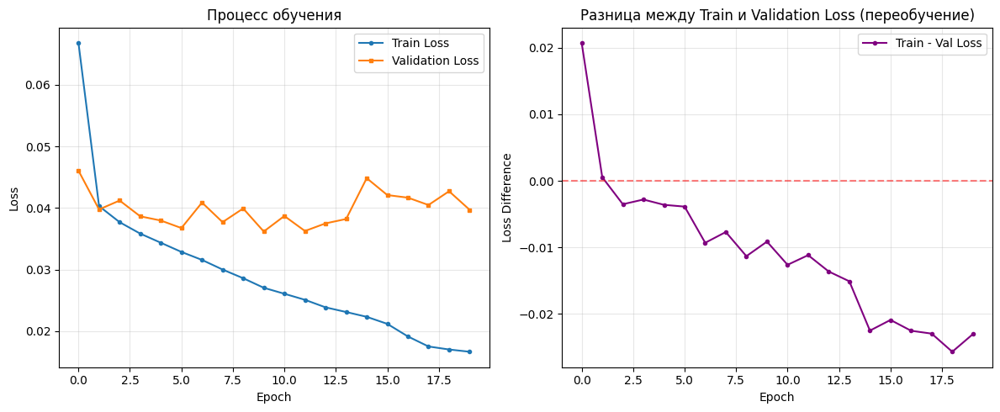

In [ ]:
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss', marker='o', markersize=3)
plt.plot(test_losses, label='Validation Loss', marker='s', markersize=3)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Процесс обучения')
plt.legend()
plt.grid(True, alpha=0.3)

plt.subplot(1, 2, 2)
plt.plot(np.array(train_losses) - np.array(test_losses), label='Train - Val Loss', marker='o', markersize=3, color='purple')
plt.axhline(y=0, color='red', linestyle='--', alpha=0.5)
plt.xlabel('Epoch')
plt.ylabel('Loss Difference')
plt.title('Разница между Train и Validation Loss (переобучение)')
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

### Мультимодальная нейросеть.

In [ ]:
class MultimodalSearchNet(nn.Module):
    def __init__(self, image_dim=2048, text_dim=768):
        super(MultimodalSearchNet, self).__init__()

        # Image branch (2048 -> 512)
        self.image_branch = nn.Sequential(
            nn.Linear(image_dim, 1024),
            nn.BatchNorm1d(1024),
            nn.ReLU(),
            nn.Dropout(0.4),

            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.3),
        )

        # Text branch (768 -> 512)
        self.text_branch = nn.Sequential(
            nn.Linear(text_dim, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.3),
        )

        # Fusion layers (512 + 512 = 1024 -> 1)
        self.fusion = nn.Sequential(
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.4),

            nn.Linear(512, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Dropout(0.3),

            nn.Linear(256, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.2),

            nn.Linear(128, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        # Разделяем входные данные на image и text embeddings
        image_features = x[:, :2048]  # Первые 2048 признаков - изображение
        text_features = x[:, 2048:]   # Оставшиеся 768 - текст

        # Обрабатываем каждую модальность отдельно
        image_out = self.image_branch(image_features)
        text_out = self.text_branch(text_features)

        # Объединяем (concatenate)
        combined = torch.cat([image_out, text_out], dim=1)

        # Финальная классификация
        output = self.fusion(combined)
        return output

In [ ]:
X_train_tensor = torch.FloatTensor(X_train).to(device)
y_train_tensor = torch.FloatTensor(y_train).unsqueeze(1).to(device)
X_test_tensor = torch.FloatTensor(X_test).to(device)
y_test_tensor = torch.FloatTensor(y_test).unsqueeze(1).to(device)

train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True)


In [ ]:
model_modal = MultimodalSearchNet(image_dim=2048, text_dim=768).to(device)

print(f"\n{'='*60}")
print("Архитектура мультимодальной нейронной сети:")
print(f"{'='*60}")
print(model_modal)
print(f"\nОбщее количество параметров: {sum(p.numel() for p in model_modal.parameters()):,}")
print(f"{'='*60}\n")

# Оптимизированные параметры для мультимодального обучения
criterion = nn.MSELoss()
optimizer = optim.AdamW(model_modal.parameters(), lr=0.0005, weight_decay=1e-4)  # AdamW + меньший lr
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.5,
    patience=7,
    min_lr=1e-6
)


Архитектура мультимодальной нейронной сети:
MultimodalSearchNet(
  (image_branch): Sequential(
    (0): Linear(in_features=2048, out_features=1024, bias=True)
    (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout(p=0.4, inplace=False)
    (4): Linear(in_features=1024, out_features=512, bias=True)
    (5): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): Dropout(p=0.3, inplace=False)
  )
  (text_branch): Sequential(
    (0): Linear(in_features=768, out_features=512, bias=True)
    (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout(p=0.3, inplace=False)
  )
  (fusion): Sequential(
    (0): Linear(in_features=1024, out_features=512, bias=True)
    (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout(p=0.4, inplace=False)
    (4): L

In [ ]:
num_epochs = 50
best_test_loss = float('inf')
patience_counter = 0
early_stopping_patience = 15

best_model_state = None
best_test_metrics = {}
best_epoch = 0

train_losses = []
test_losses = []
train_maes = []
test_maes = []
train_r2s = []
test_r2s = []

# Функция для вычисления R² score
def r2_score(y_true, y_pred):
    ss_res = torch.sum((y_true - y_pred) ** 2)
    ss_tot = torch.sum((y_true - torch.mean(y_true)) ** 2)
    return 1 - ss_res / (ss_tot + 1e-8)

# Функция для вычисления MAE
def mean_absolute_error(y_true, y_pred):
    return torch.mean(torch.abs(y_true - y_pred))

for epoch in range(num_epochs):
    # Режим обучения
    model_modal.train()
    train_loss = 0.0
    train_mae_sum = 0.0
    train_r2_sum = 0.0
    train_batches = 0

    for batch_X, batch_y in train_loader:
        optimizer.zero_grad()

        outputs = model_modal(batch_X)
        loss = criterion(outputs, batch_y)

        loss.backward()
        torch.nn.utils.clip_grad_norm_(model_modal.parameters(), max_norm=1.0)
        optimizer.step()

        train_loss += loss.item() * batch_X.size(0)

        # Вычисляем метрики для батча
        train_mae_sum += mean_absolute_error(batch_y, outputs).item() * batch_X.size(0)
        train_r2_sum += r2_score(batch_y, outputs).item() * batch_X.size(0)
        train_batches += batch_X.size(0)

    # Средние метрики на тренировочном наборе
    train_loss /= train_batches
    train_mae = train_mae_sum / train_batches
    train_r2 = train_r2_sum / train_batches

    train_losses.append(train_loss)
    train_maes.append(train_mae)
    train_r2s.append(train_r2)

    # Валидация на test выборке
    model_modal.eval()
    with torch.no_grad():
        test_outputs = model_modal(X_test_tensor)
        test_loss = criterion(test_outputs, y_test_tensor).item()
        test_losses.append(test_loss)

        # Test метрики
        test_mae = mean_absolute_error(y_test_tensor, test_outputs).item()
        test_r2 = r2_score(y_test_tensor, test_outputs).item()
        test_maes.append(test_mae)
        test_r2s.append(test_r2)

    # Обновление learning rate
    old_lr = optimizer.param_groups[0]['lr']
    scheduler.step(test_loss)
    new_lr = optimizer.param_groups[0]['lr']

    # Early stopping и сохранение лучшей модели
    improvement_marker = ""
    if test_loss < best_test_loss:
        best_test_loss = test_loss
        best_test_metrics = {
            'mae': test_mae,
            'r2': test_r2,
            'loss': test_loss
        }
        best_epoch = epoch + 1
        patience_counter = 0
        improvement_marker = "⭐ [BEST]"

        # Сохраняем состояние лучшей модели
        best_model_state = copy.deepcopy(model_modal.state_dict())

    else:
        patience_counter += 1

    # Вывод информации о каждой эпохе
    lr_change = ""
    if old_lr != new_lr:
        lr_change = f" | LR: {old_lr:.6f} -> {new_lr:.6f}"

    print(f"Epoch [{epoch+1:3d}/{num_epochs}] | "
          f"TrLoss: {train_loss:.4f} | TeLoss: {test_loss:.4f} | "
          f"TrMAE: {train_mae:.4f} | TeMAE: {test_mae:.4f} | "
          f"TrR²: {train_r2:.4f} | TeR²: {test_r2:.4f} | "
          f"Pat: {patience_counter}/{early_stopping_patience} "
          f"{improvement_marker}{lr_change}")

    if patience_counter >= early_stopping_patience:
        print(f"\n{'='*60}")
        print(f"Early stopping на эпохе {epoch+1}")
        print(f"Лучший Test Loss: {best_test_loss:.4f} (эпоха {best_epoch})")
        print(f"Лучший Test MAE: {best_test_metrics['mae']:.4f}")
        print(f"Лучший Test R²: {best_test_metrics['r2']:.4f}")
        print(f"{'='*60}\n")
        break

# Загрузка лучшей модели
if best_model_state is not None:
    model_modal.load_state_dict(best_model_state)

Epoch [  1/50] | TrLoss: 0.0664 | TeLoss: 0.0415 | TrMAE: 0.2037 | TeMAE: 0.1488 | TrR²: -0.6000 | TeR²: 0.0194 | Pat: 0/15 ⭐ [BEST]
Epoch [  2/50] | TrLoss: 0.0417 | TeLoss: 0.0400 | TrMAE: 0.1299 | TeMAE: 0.1294 | TrR²: 0.0386 | TeR²: 0.0557 | Pat: 0/15 ⭐ [BEST]
Epoch [  3/50] | TrLoss: 0.0398 | TeLoss: 0.0376 | TrMAE: 0.1198 | TeMAE: 0.1165 | TrR²: 0.0761 | TeR²: 0.1122 | Pat: 0/15 ⭐ [BEST]
Epoch [  4/50] | TrLoss: 0.0383 | TeLoss: 0.0364 | TrMAE: 0.1147 | TeMAE: 0.1083 | TrR²: 0.1121 | TeR²: 0.1405 | Pat: 0/15 ⭐ [BEST]
Epoch [  5/50] | TrLoss: 0.0371 | TeLoss: 0.0376 | TrMAE: 0.1109 | TeMAE: 0.1145 | TrR²: 0.1421 | TeR²: 0.1111 | Pat: 1/15 
Epoch [  6/50] | TrLoss: 0.0361 | TeLoss: 0.0369 | TrMAE: 0.1086 | TeMAE: 0.1025 | TrR²: 0.1656 | TeR²: 0.1283 | Pat: 2/15 
Epoch [  7/50] | TrLoss: 0.0355 | TeLoss: 0.0363 | TrMAE: 0.1072 | TeMAE: 0.1078 | TrR²: 0.1708 | TeR²: 0.1421 | Pat: 0/15 ⭐ [BEST]
Epoch [  8/50] | TrLoss: 0.0342 | TeLoss: 0.0369 | TrMAE: 0.1039 | TeMAE: 0.1060 | TrR²: 0.

In [ ]:
model_modal.eval()

with torch.no_grad():
    # Предсказания на тренировочном наборе
    y_train_pred_tensor = model_modal(X_train_tensor)
    y_train_pred = y_train_pred_tensor.cpu().numpy().flatten()
    y_train_true = y_train_tensor.cpu().numpy().flatten()

    # Предсказания на тестовом наборе
    y_test_pred_tensor = model_modal(X_test_tensor)
    y_test_pred = y_test_pred_tensor.cpu().numpy().flatten()
    y_test_true = y_test_tensor.cpu().numpy().flatten()

In [ ]:
# Метрики на train
print(f"\n{'='*60}")
print("📊 Финальные метрики на TRAIN:")
print(f"{'='*60}")
print(f"MSE (Loss): {np.mean((y_train_true - y_train_pred) ** 2):.4f}")
print(f"RMSE: {np.sqrt(np.mean((y_train_true - y_train_pred) ** 2)):.4f}")
print(f"MAE: {np.mean(np.abs(y_train_true - y_train_pred)):.4f}")

# R² score на train
ss_res_train = np.sum((y_train_true - y_train_pred) ** 2)
ss_tot_train = np.sum((y_train_true - np.mean(y_train_true)) ** 2)
r2_train = 1 - (ss_res_train / (ss_tot_train + 1e-8))
print(f"R² score: {r2_train:.4f}")

# Метрики на test
print(f"\n{'='*60}")
print("📊 Финальные метрики на TEST:")
print(f"{'='*60}")
print(f"MSE (Loss): {np.mean((y_test_true - y_test_pred) ** 2):.4f}")
print(f"RMSE: {np.sqrt(np.mean((y_test_true - y_test_pred) ** 2)):.4f}")
print(f"MAE: {np.mean(np.abs(y_test_true - y_test_pred)):.4f}")

# R² score на test
ss_res_test = np.sum((y_test_true - y_test_pred) ** 2)
ss_tot_test = np.sum((y_test_true - np.mean(y_test_true)) ** 2)
r2_test = 1 - (ss_res_test / (ss_tot_test + 1e-8))
print(f"R² score: {r2_test:.4f}")


📊 Финальные метрики на TRAIN:
MSE (Loss): 0.0253
RMSE: 0.1591
MAE: 0.0816
R² score: 0.4273

📊 Финальные метрики на TEST:
MSE (Loss): 0.0354
RMSE: 0.1882
MAE: 0.0974
R² score: 0.1636


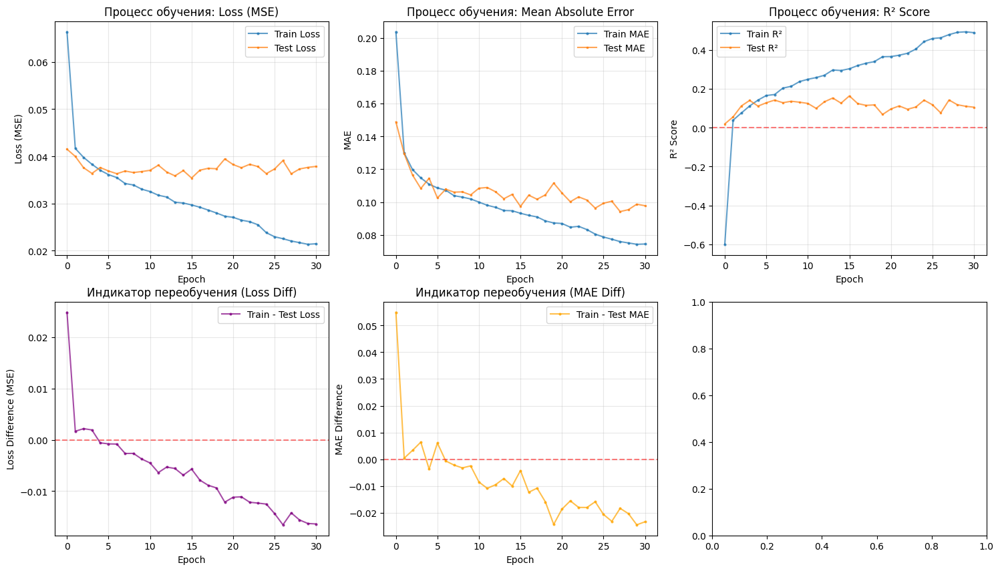

In [ ]:
fig, axes = plt.subplots(2, 3, figsize=(18, 10))

# График 1: Loss (MSE)
axes[0, 0].plot(train_losses, label='Train Loss', marker='o', markersize=2, alpha=0.7)
axes[0, 0].plot(test_losses, label='Test Loss', marker='s', markersize=2, alpha=0.7)
axes[0, 0].set_xlabel('Epoch')
axes[0, 0].set_ylabel('Loss (MSE)')
axes[0, 0].set_title('Процесс обучения: Loss (MSE)')
axes[0, 0].legend()
axes[0, 0].grid(True, alpha=0.3)

# График 2: MAE
axes[0, 1].plot(train_maes, label='Train MAE', marker='o', markersize=2, alpha=0.7)
axes[0, 1].plot(test_maes, label='Test MAE', marker='s', markersize=2, alpha=0.7)
axes[0, 1].set_xlabel('Epoch')
axes[0, 1].set_ylabel('MAE')
axes[0, 1].set_title('Процесс обучения: Mean Absolute Error')
axes[0, 1].legend()
axes[0, 1].grid(True, alpha=0.3)

# График 3: R² Score
axes[0, 2].plot(train_r2s, label='Train R²', marker='o', markersize=2, alpha=0.7)
axes[0, 2].plot(test_r2s, label='Test R²', marker='s', markersize=2, alpha=0.7)
axes[0, 2].set_xlabel('Epoch')
axes[0, 2].set_ylabel('R² Score')
axes[0, 2].set_title('Процесс обучения: R² Score')
axes[0, 2].legend()
axes[0, 2].grid(True, alpha=0.3)
# Горизонтальная линия для R² = 0 (случайное предсказание)
axes[0, 2].axhline(y=0, color='red', linestyle='--', alpha=0.5)

# График 4: Overfitting - Loss разница
loss_diff = np.array(train_losses) - np.array(test_losses)
axes[1, 0].plot(loss_diff, label='Train - Test Loss', marker='o', markersize=2, color='purple', alpha=0.7)
axes[1, 0].axhline(y=0, color='red', linestyle='--', alpha=0.5)
axes[1, 0].set_xlabel('Epoch')
axes[1, 0].set_ylabel('Loss Difference (MSE)')
axes[1, 0].set_title('Индикатор переобучения (Loss Diff)')
axes[1, 0].legend()
axes[1, 0].grid(True, alpha=0.3)

# График 5: Overfitting - MAE разница
mae_diff = np.array(train_maes) - np.array(test_maes)
axes[1, 1].plot(mae_diff, label='Train - Test MAE', marker='o', markersize=2, color='orange', alpha=0.7)
axes[1, 1].axhline(y=0, color='red', linestyle='--', alpha=0.5)
axes[1, 1].set_xlabel('Epoch')
axes[1, 1].set_ylabel('MAE Difference')
axes[1, 1].set_title('Индикатор переобучения (MAE Diff)')
axes[1, 1].legend()
axes[1, 1].grid(True, alpha=0.3)


### Проверка на тестовых данных.

Проделаем аналогичные шаги для тестовой выборки.

In [ ]:
IMAGE_DIR = './test_images'

In [ ]:
dataset = ImageDataset(df_test, IMAGE_DIR, transform)
dataloader = DataLoader(
    dataset,
    batch_size=64,
    shuffle=False,  # убрал
    num_workers=0,
    pin_memory=True
)

all_embeddings = []

model_res50.eval()

with torch.no_grad():
    for batch in tqdm(dataloader, desc="Извлечение эмбеддингов"):
        batch = batch.to(device)

        embeddings = model_res50(batch)

        embeddings = embeddings.squeeze(-1).squeeze(-1)

        embeddings = embeddings.cpu().numpy()
        all_embeddings.append(embeddings)



Извлечение эмбеддингов: 100%|██████████| 2/2 [00:00<00:00,  3.90it/s]


In [ ]:
test_foto_embeddings = np.vstack(all_embeddings)
test_foto_embeddings.shape

(100, 2048)

In [ ]:
SEED = 42
np.random.seed(SEED)

unique_values = df_test_que['query_text'].unique()

random_sample = np.random.choice(unique_values, size=min(5, len(unique_values)), replace=False)

In [ ]:
random_sample = random_sample.tolist()
random_sample

['A group of girls who are gothically dressed standing together',
 'A woman and girl riding downhill on a sled with a dog running alongside them',
 'The dog is running .',
 'A group of people are ice skating in a big city .',
 'Little kid in blue coat and hat riding a tricycle .']

In [ ]:
def find_top_images(text_description, tokenizer, bert_model, model,
                    image_embeddings, image_paths=None, top_k=5,
                    device='cuda', show_images=True, figsize=(15, 3),
                    child_patterns=None):
    """
    Находит top-K изображений по текстовому описанию с использованием линейной регрессии.

    Parameters:
    -----------
    text_description : str or list
        Текстовое описание или список описаний
    tokenizer : AutoTokenizer
        BERT токенизатор
    bert_model : AutoModel
        BERT модель для эмбеддингов
    model : Pipeline
        Pipeline с StandardScaler и LinearRegression
    image_embeddings : numpy.ndarray
        Эмбеддинги изображений, shape (n_images, embedding_dim)
    image_paths : list or str, optional
        Список путей к изображениям или путь к директории
    top_k : int, default=5
        Количество лучших результатов
    device : str
        Устройство ('cuda' или 'cpu')
    show_images : bool
        Показывать ли изображения
    figsize : tuple
        Размер фигуры для отображения
    child_patterns : list, optional
        Список паттернов для блокировки контента

    Returns:
    --------
    results : list of dict or dict of lists
        Результаты с полем 'score'
    """
    # Компиляция паттернов для проверки
    combined_pattern = None
    if child_patterns:
        combined_pattern = re.compile('|'.join(child_patterns), re.IGNORECASE)

    # Загрузка путей из директории, если нужно
    image_paths = _load_image_paths(image_paths, len(image_embeddings))

    # Обработка списка запросов
    if isinstance(text_description, list):
        return _process_multiple_queries(
            text_description, tokenizer, bert_model, model,
            image_embeddings, image_paths, top_k, device, show_images,
            figsize, combined_pattern
        )

    # Проверка одного запроса на запрещенный контент
    if combined_pattern and combined_pattern.search(text_description):
        print("This image is unavailable in your country in compliance with local laws.")
        return None

    # Обработка одного запроса
    return _process_query(
        text_description, tokenizer, bert_model, model,
        image_embeddings, image_paths, top_k, device, show_images, figsize
    )


def _load_image_paths(image_paths, expected_count):
    """Загружает пути к изображениям из директории или проверяет список."""
    if isinstance(image_paths, str):
        image_dir = Path(image_paths)
        if not image_dir.is_dir():
            raise ValueError(f"Директория не найдена: {image_paths}")

        extensions = {'.jpg', '.jpeg', '.png', '.gif', '.bmp', '.tiff'}
        paths = sorted([
            str(f) for f in image_dir.iterdir()
            if f.suffix.lower() in extensions
        ])
        print(f"Загружено {len(paths)} изображений из директории")
        return paths

    if image_paths is not None and len(image_paths) != expected_count:
        raise ValueError(
            f"Несоответствие: {len(image_paths)} путей и {expected_count} эмбеддингов"
        )

    return image_paths


def _get_text_embedding(text, tokenizer, bert_model, device):
    """Получает эмбеддинг текста через BERT."""
    with torch.no_grad():
        inputs = tokenizer(
            text, return_tensors="pt", padding=True,
            truncation=True, max_length=128                           # Длинна такая же как на трейне
        ).to(device)
        outputs = bert_model(**inputs)
        return outputs.last_hidden_state[:, 0, :].cpu().numpy()[0]


def _calculate_scores(text_embedding, image_embeddings, model):
    """Вычисляет scores для всех изображений."""
    scores = []
    for img_emb in image_embeddings:
        combined = np.concatenate([img_emb, text_embedding]).reshape(1, -1) # Объединение foto+text как при обучении
        score = model.predict(combined)[0]
        scores.append(score)
    return np.array(scores)


def _process_query(text, tokenizer, bert_model, model, image_embeddings,
                   image_paths, top_k, device, show_images, figsize):
    """Обрабатывает один текстовый запрос."""
    # Получение эмбеддинга текста
    text_emb = _get_text_embedding(text, tokenizer, bert_model, device)

    # Расчет scores
    scores = _calculate_scores(text_emb, image_embeddings, model)

    # Топ-K индексов
    top_indices = np.argsort(scores)[-top_k:][::-1]

    # Формирование результатов
    results = [
        {
            'rank': rank,
            'index': int(idx),
            'score': float(scores[idx]),
            'embedding': image_embeddings[idx],
            **({'image_path': image_paths[idx]} if image_paths else {})
        }
        for rank, idx in enumerate(top_indices, 1)
    ]

    # Вывод
    print(f"Поиск: '{text}'")
    print(f"\nТоп-{top_k} изображений:\n")
    for res in results:
        path = f", {res['image_path']}" if 'image_path' in res else ""
        print(f"{res['rank']}. Индекс: {res['index']}, Score: {res['score']:.4f}{path}")

    # Визуализация
    if show_images and image_paths:
        _display_images(results, top_k, figsize)

    return results


def _process_multiple_queries(queries, tokenizer, bert_model, model,
                              image_embeddings, image_paths, top_k,
                              device, show_images, figsize, combined_pattern):
    """Обрабатывает несколько запросов."""
    print(f"Обработка {len(queries)} фраз...\n")
    all_results = {}

    for i, query in enumerate(queries, 1):
        print(f"\n{'='*80}")
        print(f"Фраза {i}/{len(queries)}: '{query}'")
        print(f"{'='*80}")

        # Проверка на запрещенный контент
        if combined_pattern and combined_pattern.search(query):
            print("This image is unavailable in your country in compliance with local laws.")
            all_results[query] = None
            continue

        results = _process_query(
            query, tokenizer, bert_model, model,
            image_embeddings, image_paths, top_k,
            device, show_images, figsize
        )
        all_results[query] = results

    print(f"\n{'='*80}")
    print(f"Обработано фраз: {len(queries)}")
    print(f"Успешно: {sum(1 for v in all_results.values() if v is not None)}")
    print(f"Заблокировано: {sum(1 for v in all_results.values() if v is None)}")
    print(f"{'='*80}")

    return all_results


def _display_images(results, top_k, figsize):
    """Отображает найденные изображения."""
    fig, axes = plt.subplots(1, top_k, figsize=figsize)
    axes = [axes] if top_k == 1 else axes

    for ax, res in zip(axes, results):
        try:
            img = Image.open(res['image_path'])
            ax.imshow(img)
            ax.axis('off')
            ax.set_title(f"#{res['rank']}: {res['score']:.3f}",
                        fontsize=10, pad=5)
        except Exception:
            ax.text(0.5, 0.5, "Ошибка\nзагрузки",
                   ha='center', va='center', transform=ax.transAxes)
            ax.axis('off')

    plt.tight_layout()
    plt.show()

Загружено 100 изображений из директории
Обработка 5 фраз...


Фраза 1/5: 'A group of girls who are gothically dressed standing together'
Поиск: 'A group of girls who are gothically dressed standing together'

Топ-5 изображений:

1. Индекс: 81, Score: 0.1316, test_images\3653484549_f316590b0f.jpg
2. Индекс: 90, Score: 0.1131, test_images\607339469_af851c4119.jpg
3. Индекс: 3, Score: 0.1124, test_images\1319634306_816f21677f.jpg
4. Индекс: 40, Score: 0.1046, test_images\3033612929_764d977bd5.jpg
5. Индекс: 10, Score: 0.0999, test_images\1991806812_065f747689.jpg


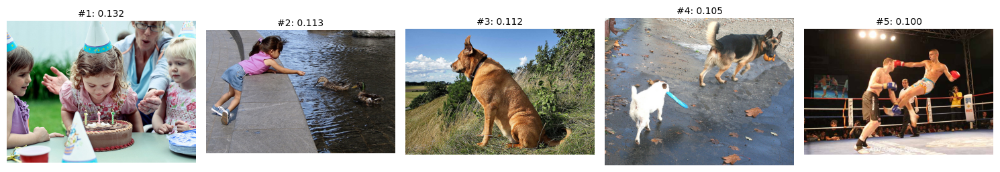


Фраза 2/5: 'A woman and girl riding downhill on a sled with a dog running alongside them'
This image is unavailable in your country in compliance with local laws.

Фраза 3/5: 'The dog is running .'
Поиск: 'The dog is running .'

Топ-5 изображений:

1. Индекс: 81, Score: 0.2632, test_images\3653484549_f316590b0f.jpg
2. Индекс: 90, Score: 0.2446, test_images\607339469_af851c4119.jpg
3. Индекс: 3, Score: 0.2439, test_images\1319634306_816f21677f.jpg
4. Индекс: 40, Score: 0.2362, test_images\3033612929_764d977bd5.jpg
5. Индекс: 10, Score: 0.2314, test_images\1991806812_065f747689.jpg


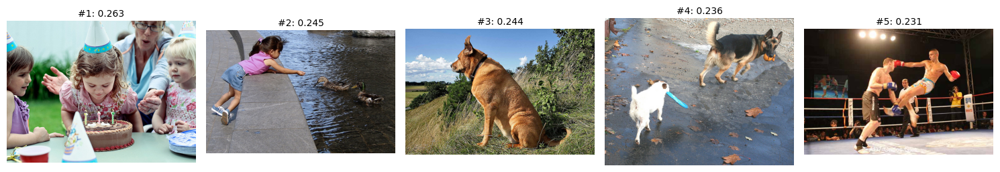


Фраза 4/5: 'A group of people are ice skating in a big city .'
Поиск: 'A group of people are ice skating in a big city .'

Топ-5 изображений:

1. Индекс: 81, Score: 0.2070, test_images\3653484549_f316590b0f.jpg
2. Индекс: 90, Score: 0.1885, test_images\607339469_af851c4119.jpg
3. Индекс: 3, Score: 0.1878, test_images\1319634306_816f21677f.jpg
4. Индекс: 40, Score: 0.1800, test_images\3033612929_764d977bd5.jpg
5. Индекс: 10, Score: 0.1753, test_images\1991806812_065f747689.jpg


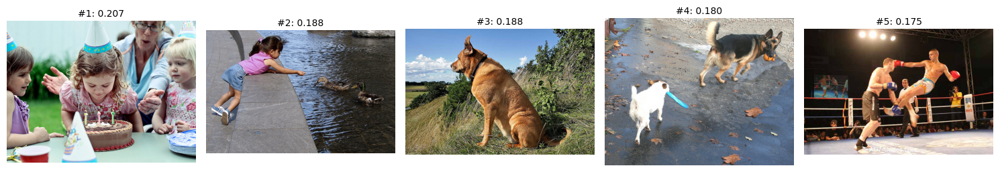


Фраза 5/5: 'Little kid in blue coat and hat riding a tricycle .'
This image is unavailable in your country in compliance with local laws.

Обработано фраз: 5
Успешно: 3
Заблокировано: 2


In [ ]:
results = find_top_images(
        text_description=random_sample,
        tokenizer=tokenizer,
        bert_model=bert_model,
        model=best_model_sc,
        image_embeddings=test_foto_embeddings,
        image_paths=IMAGE_DIR,
        top_k=5,
        device='cuda',
        show_images=True,
        child_patterns=child_patterns)

In [ ]:
def find_top_images_nn(text_description, tokenizer, bert_model, model,
                    image_embeddings, image_paths=None, top_k=5,
                    device='cuda', show_images=True, figsize=(15, 3),
                    child_patterns=None):
    """
    Находит top-K изображений по текстовому описанию с использованием нейросети.

    Parameters:
    -----------
    text_description : str or list
        Текстовое описание или список описаний
    tokenizer : AutoTokenizer
        BERT токенизатор
    bert_model : AutoModel
        BERT модель для эмбеддингов
    model : torch.nn.Module
        Обученная нейросеть для предсказания соответствия
    image_embeddings : numpy.ndarray or torch.Tensor
        Эмбеддинги изображений, shape (n_images, embedding_dim)
    image_paths : list or str, optional
        Список путей к изображениям или путь к директории
    top_k : int, default=5
        Количество лучших результатов
    device : str
        Устройство ('cuda' или 'cpu')
    show_images : bool
        Показывать ли изображения
    figsize : tuple
        Размер фигуры для отображения
    child_patterns : list, optional
        Список паттернов для блокировки контента

    Returns:
    --------
    results : list of dict or dict of lists
        Результаты с полем 'score' или 'probability'
    """
    # Компиляция паттернов для проверки
    combined_pattern = None
    if child_patterns:
        combined_pattern = re.compile('|'.join(child_patterns), re.IGNORECASE)

    # Загрузка путей из директории, если нужно
    image_paths = _load_image_paths(image_paths, len(image_embeddings))

    # Конвертация в torch.Tensor если нужно
    if isinstance(image_embeddings, np.ndarray):
        image_embeddings = torch.from_numpy(image_embeddings).float()

    # Обработка списка запросов
    if isinstance(text_description, list):
        return _process_multiple_queries(
            text_description, tokenizer, bert_model, model,
            image_embeddings, image_paths, top_k, device, show_images,
            figsize, combined_pattern
        )

    # Проверка одного запроса на запрещенный контент
    if combined_pattern and combined_pattern.search(text_description):
        print("This image is unavailable in your country in compliance with local laws.")
        return None

    # Обработка одного запроса
    return _process_query(
        text_description, tokenizer, bert_model, model,
        image_embeddings, image_paths, top_k, device, show_images, figsize
    )


def _load_image_paths(image_paths, expected_count):
    """Загружает пути к изображениям из директории или проверяет список."""
    if isinstance(image_paths, str):
        image_dir = Path(image_paths)
        if not image_dir.is_dir():
            raise ValueError(f"Директория не найдена: {image_paths}")

        extensions = {'.jpg', '.jpeg', '.png', '.gif', '.bmp', '.tiff'}
        paths = sorted([
            str(f) for f in image_dir.iterdir()
            if f.suffix.lower() in extensions
        ])
        print(f"Загружено {len(paths)} изображений из директории")
        return paths

    if image_paths is not None and len(image_paths) != expected_count:
        raise ValueError(
            f"Несоответствие: {len(image_paths)} путей и {expected_count} эмбеддингов"
        )

    return image_paths


def _get_text_embedding(text, tokenizer, bert_model, device):
    """Получает эмбеддинг текста через BERT."""
    with torch.no_grad():
        inputs = tokenizer(
            text, return_tensors="pt", padding=True,
            truncation=True, max_length=128
        ).to(device)
        outputs = bert_model(**inputs)
        return outputs.last_hidden_state[:, 0, :]  # (1, hidden_size)


def _calculate_scores(text_embedding, image_embeddings, model, device):
    """Вычисляет scores для всех изображений через нейросеть."""
    model.eval()

    with torch.no_grad():
        # Перемещаем на нужное устройство
        text_embedding = text_embedding.to(device)
        image_embeddings = image_embeddings.to(device)

        # Повторяем текстовый эмбеддинг для всех изображений
        batch_size = len(image_embeddings)
        text_batch = text_embedding.repeat(batch_size, 1)  # (batch_size, text_dim)

        # Объединяем эмбеддинги
        combined = torch.cat([image_embeddings, text_batch], dim=1)  # Поменял на img+text

        # Прогоняем через модель
        outputs = model(combined)

        # Если модель возвращает логиты для классификации, применяем sigmoid/softmax
        if outputs.shape[-1] == 1:
            # Бинарная классификация или регрессия
            scores = outputs.squeeze(-1)
            # Если это классификация, применяем sigmoid для получения вероятности
            if hasattr(model, 'output_type') and model.output_type == 'classification':
                scores = torch.sigmoid(scores)
        elif outputs.shape[-1] == 2:
            # Две категории - берем вероятность положительного класса
            scores = F.softmax(outputs, dim=1)[:, 1]
        else:
            # Многоклассовая классификация - берем максимальную вероятность
            scores = F.softmax(outputs, dim=1).max(dim=1)[0]

        return scores.cpu().numpy()


def _process_query(text, tokenizer, bert_model, model, image_embeddings,
                   image_paths, top_k, device, show_images, figsize):
    """Обрабатывает один текстовый запрос."""
    # Получение эмбеддинга текста
    text_emb = _get_text_embedding(text, tokenizer, bert_model, device)

    # Расчет scores через нейросеть
    scores = _calculate_scores(text_emb, image_embeddings, model, device)

    # Топ-K индексов
    top_indices = np.argsort(scores)[-top_k:][::-1]

    # Формирование результатов
    results = [
        {
            'rank': rank,
            'index': int(idx),
            'score': float(scores[idx]),
            'embedding': image_embeddings[idx].cpu().numpy() if isinstance(image_embeddings, torch.Tensor) else image_embeddings[idx],
            **({'image_path': image_paths[idx]} if image_paths else {})
        }
        for rank, idx in enumerate(top_indices, 1)
    ]

    # Вывод
    print(f"Поиск: '{text}'")
    print(f"\nТоп-{top_k} изображений:\n")
    for res in results:
        path = f", {res['image_path']}" if 'image_path' in res else ""
        print(f"{res['rank']}. Индекс: {res['index']}, Score: {res['score']:.4f}{path}")

    # Визуализация
    if show_images and image_paths:
        _display_images(results, top_k, figsize)

    return results


def _process_multiple_queries(queries, tokenizer, bert_model, model,
                              image_embeddings, image_paths, top_k,
                              device, show_images, figsize, combined_pattern):
    """Обрабатывает несколько запросов."""
    print(f"Обработка {len(queries)} фраз...\n")
    all_results = {}

    for i, query in enumerate(queries, 1):
        print(f"\n{'='*80}")
        print(f"Фраза {i}/{len(queries)}: '{query}'")
        print(f"{'='*80}")

        # Проверка на запрещенный контент
        if combined_pattern and combined_pattern.search(query):
            print("This image is unavailable in your country in compliance with local laws.")
            all_results[query] = None
            continue

        results = _process_query(
            query, tokenizer, bert_model, model,
            image_embeddings, image_paths, top_k,
            device, show_images, figsize
        )
        all_results[query] = results

    print(f"\n{'='*80}")
    print(f"Обработано фраз: {len(queries)}")
    print(f"Успешно: {sum(1 for v in all_results.values() if v is not None)}")
    print(f"Заблокировано: {sum(1 for v in all_results.values() if v is None)}")
    print(f"{'='*80}")

    return all_results


def _display_images(results, top_k, figsize):
    """Отображает найденные изображения."""
    fig, axes = plt.subplots(1, top_k, figsize=figsize)
    axes = [axes] if top_k == 1 else axes

    for ax, res in zip(axes, results):
        try:
            img = Image.open(res['image_path'])
            ax.imshow(img)
            ax.axis('off')
            ax.set_title(f"#{res['rank']}: {res['score']:.3f}",
                        fontsize=10, pad=5)
        except Exception:
            ax.text(0.5, 0.5, "Ошибка\nзагрузки",
                   ha='center', va='center', transform=ax.transAxes)
            ax.axis('off')

    plt.tight_layout()
    plt.show()

Загружено 100 изображений из директории
Обработка 5 фраз...


Фраза 1/5: 'A group of girls who are gothically dressed standing together'
Поиск: 'A group of girls who are gothically dressed standing together'

Топ-5 изображений:

1. Индекс: 92, Score: 0.1573, test_images\661749711_6f408dad62.jpg
2. Индекс: 97, Score: 0.1157, test_images\973827791_467d83986e.jpg
3. Индекс: 46, Score: 0.1100, test_images\3119913014_688d4997d7.jpg
4. Индекс: 21, Score: 0.0925, test_images\2431120202_b24fe2333a.jpg
5. Индекс: 38, Score: 0.0887, test_images\2986716822_e220754d32.jpg


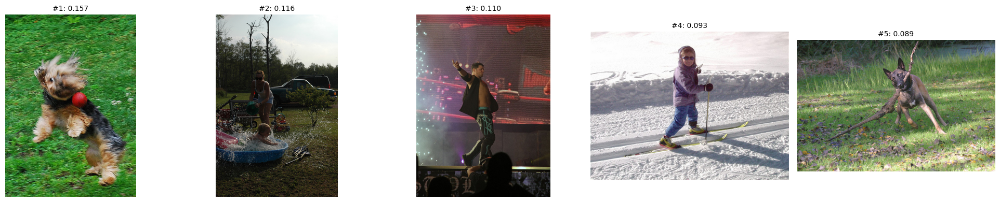


Фраза 2/5: 'A woman and girl riding downhill on a sled with a dog running alongside them'
This image is unavailable in your country in compliance with local laws.

Фраза 3/5: 'The dog is running .'
Поиск: 'The dog is running .'

Топ-5 изображений:

1. Индекс: 47, Score: 0.6097, test_images\3122579598_14841c038a.jpg
2. Индекс: 14, Score: 0.5847, test_images\2141713971_e25eb12712.jpg
3. Индекс: 51, Score: 0.5493, test_images\3170110692_d1e0e66cee.jpg
4. Индекс: 86, Score: 0.4969, test_images\404850242_3a55a4c874.jpg
5. Индекс: 66, Score: 0.4792, test_images\3435015880_eda46ff50f.jpg


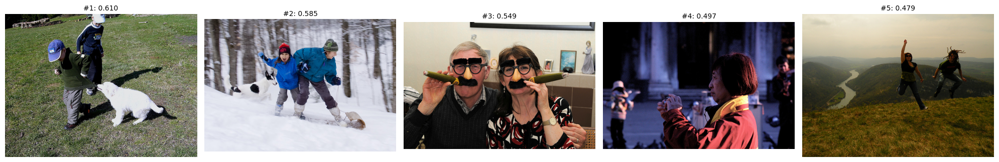


Фраза 4/5: 'A group of people are ice skating in a big city .'
Поиск: 'A group of people are ice skating in a big city .'

Топ-5 изображений:

1. Индекс: 91, Score: 0.2995, test_images\634891010_9fa189effb.jpg
2. Индекс: 90, Score: 0.2981, test_images\607339469_af851c4119.jpg
3. Индекс: 72, Score: 0.2819, test_images\3482859574_3908de3427.jpg
4. Индекс: 34, Score: 0.2795, test_images\2737233999_34d60dc5c3.jpg
5. Индекс: 58, Score: 0.2753, test_images\3330333217_1a69497a74.jpg


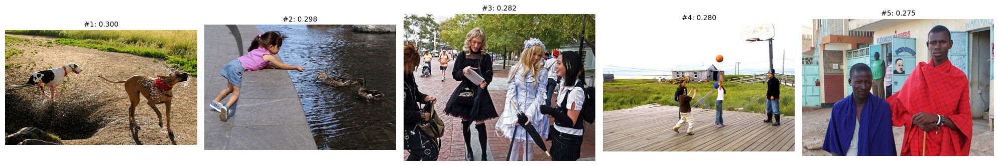


Фраза 5/5: 'Little kid in blue coat and hat riding a tricycle .'
This image is unavailable in your country in compliance with local laws.

Обработано фраз: 5
Успешно: 3
Заблокировано: 2


In [ ]:
results = find_top_images_nn(
    text_description=random_sample,
    tokenizer=tokenizer,
    bert_model=bert_model,
    model=model_nn,
    image_embeddings=test_foto_embeddings,
    image_paths=IMAGE_DIR,
    top_k=5,
    device=device,
    show_images=True,
    figsize=(20, 4),
    child_patterns=child_patterns
)

Загружено 100 изображений из директории
Обработка 5 фраз...


Фраза 1/5: 'A group of girls who are gothically dressed standing together'
Поиск: 'A group of girls who are gothically dressed standing together'

Топ-5 изображений:

1. Индекс: 58, Score: 0.0939, test_images\3330333217_1a69497a74.jpg
2. Индекс: 98, Score: 0.0643, test_images\989754491_7e53fb4586.jpg
3. Индекс: 92, Score: 0.0643, test_images\661749711_6f408dad62.jpg
4. Индекс: 97, Score: 0.0626, test_images\973827791_467d83986e.jpg
5. Индекс: 76, Score: 0.0589, test_images\3517023411_a8fbd15230.jpg


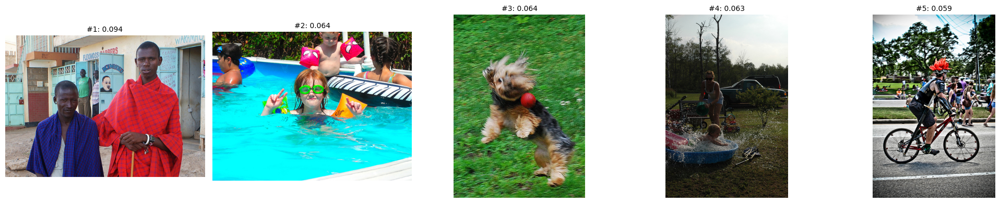


Фраза 2/5: 'A woman and girl riding downhill on a sled with a dog running alongside them'
This image is unavailable in your country in compliance with local laws.

Фраза 3/5: 'The dog is running .'
Поиск: 'The dog is running .'

Топ-5 изображений:

1. Индекс: 16, Score: 0.3798, test_images\2308256827_3c0a7d514d.jpg
2. Индекс: 14, Score: 0.3664, test_images\2141713971_e25eb12712.jpg
3. Индекс: 78, Score: 0.3622, test_images\3553476195_fb3747d7c1.jpg
4. Индекс: 66, Score: 0.3021, test_images\3435015880_eda46ff50f.jpg
5. Индекс: 47, Score: 0.3019, test_images\3122579598_14841c038a.jpg


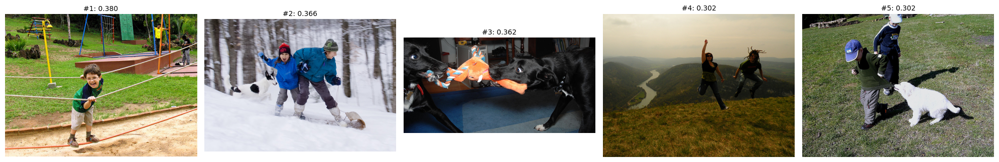


Фраза 4/5: 'A group of people are ice skating in a big city .'
Поиск: 'A group of people are ice skating in a big city .'

Топ-5 изображений:

1. Индекс: 5, Score: 0.3102, test_images\1468389504_c724bdcad0.jpg
2. Индекс: 97, Score: 0.2688, test_images\973827791_467d83986e.jpg
3. Индекс: 34, Score: 0.2039, test_images\2737233999_34d60dc5c3.jpg
4. Индекс: 33, Score: 0.1894, test_images\2714674623_8cd05ac114.jpg
5. Индекс: 85, Score: 0.1715, test_images\381514859_b40418d9c3.jpg


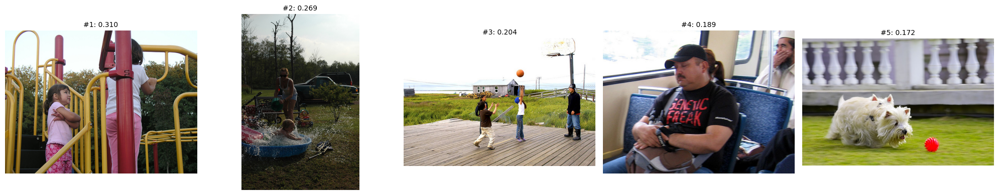


Фраза 5/5: 'Little kid in blue coat and hat riding a tricycle .'
This image is unavailable in your country in compliance with local laws.

Обработано фраз: 5
Успешно: 3
Заблокировано: 2


In [ ]:
results = find_top_images_nn(
    text_description=random_sample,
    tokenizer=tokenizer,
    bert_model=bert_model,
    model=model_modal,
    image_embeddings=test_foto_embeddings,
    image_paths=IMAGE_DIR,
    top_k=5,
    device=device,
    show_images=True,
    figsize=(20, 4),
    child_patterns=child_patterns
)

### Решение при помощи CLIP модели

Рассмотрим уже готовое решение для поиска фото по описанию.

In [ ]:
model, preprocess = clip.load("ViT-B/32", device=device)

IMAGE_DIR = './test_images'

Загружено 100 изображений из директории
Фильтр контента: ВЫКЛЮЧЕН
Обработка 5 фраз...


Фраза 1/5
Запрос: 'A group of girls who are gothically dressed standing together'
Обработка 100 изображений...

Поиск по запросу: 'A group of girls who are gothically dressed standing together'

Найдено топ-5 изображений:

1. Индекс: 72, Сходство: 0.2808, Путь: test_images\3482859574_3908de3427.jpg
2. Индекс: 94, Сходство: 0.2430, Путь: test_images\862156271_3eacea90a8.jpg
3. Индекс: 68, Сходство: 0.2349, Путь: test_images\3455405300_aa3069ecaa.jpg
4. Индекс: 37, Сходство: 0.2324, Путь: test_images\2977379863_2e8d7a104e.jpg
5. Индекс: 63, Сходство: 0.2218, Путь: test_images\3396275223_ee080df8b5.jpg


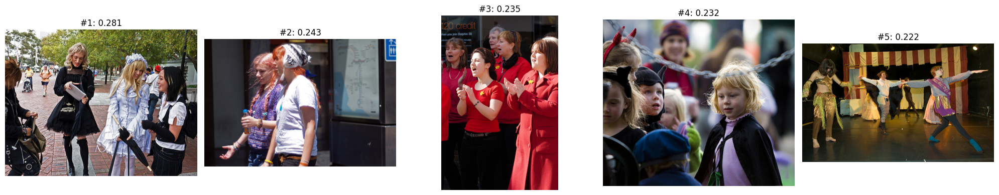


Фраза 2/5
Запрос: 'A woman and girl riding downhill on a sled with a dog running alongside them'
Обработка 100 изображений...

Поиск по запросу: 'A woman and girl riding downhill on a sled with a dog running alongside them'

Найдено топ-5 изображений:

1. Индекс: 14, Сходство: 0.3276, Путь: test_images\2141713971_e25eb12712.jpg
2. Индекс: 49, Сходство: 0.2839, Путь: test_images\3154152744_4e93ec8a62.jpg
3. Индекс: 61, Сходство: 0.2776, Путь: test_images\3386953179_84c2d7922f.jpg
4. Индекс: 55, Сходство: 0.2690, Путь: test_images\3247693965_845b3b4349.jpg
5. Индекс: 50, Сходство: 0.2505, Путь: test_images\3163198309_bbfe504f0a.jpg


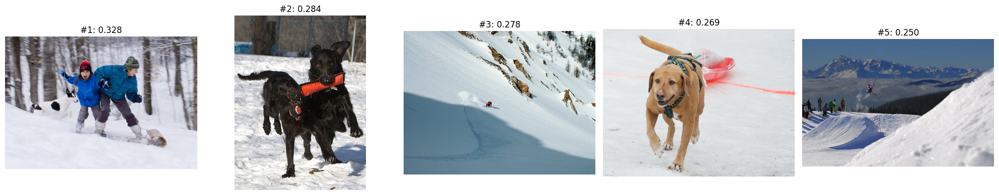


Фраза 3/5
Запрос: 'The dog is running .'
Обработка 100 изображений...

Поиск по запросу: 'The dog is running .'

Найдено топ-5 изображений:

1. Индекс: 71, Сходство: 0.2842, Путь: test_images\3466891862_9afde75568.jpg
2. Индекс: 92, Сходство: 0.2800, Путь: test_images\661749711_6f408dad62.jpg
3. Индекс: 74, Сходство: 0.2756, Путь: test_images\3488087117_2719647989.jpg
4. Индекс: 25, Сходство: 0.2742, Путь: test_images\2505465055_f1e6cf9b76.jpg
5. Индекс: 75, Сходство: 0.2732, Путь: test_images\3514297698_0512623955.jpg


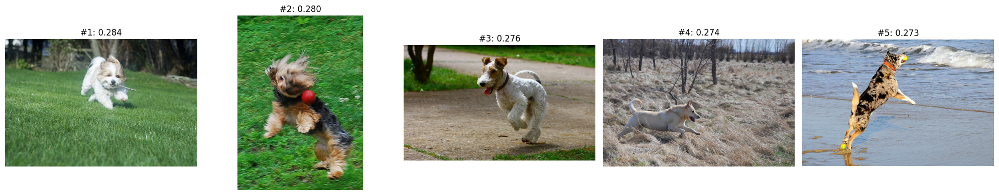


Фраза 4/5
Запрос: 'A group of people are ice skating in a big city .'
Обработка 100 изображений...

Поиск по запросу: 'A group of people are ice skating in a big city .'

Найдено топ-5 изображений:

1. Индекс: 31, Сходство: 0.3123, Путь: test_images\269650644_059a84ece5.jpg
2. Индекс: 9, Сходство: 0.2759, Путь: test_images\191003283_992257f835.jpg
3. Индекс: 88, Сходство: 0.2274, Путь: test_images\440190907_bf8b7ba8ef.jpg
4. Индекс: 37, Сходство: 0.2208, Путь: test_images\2977379863_2e8d7a104e.jpg
5. Индекс: 14, Сходство: 0.2166, Путь: test_images\2141713971_e25eb12712.jpg


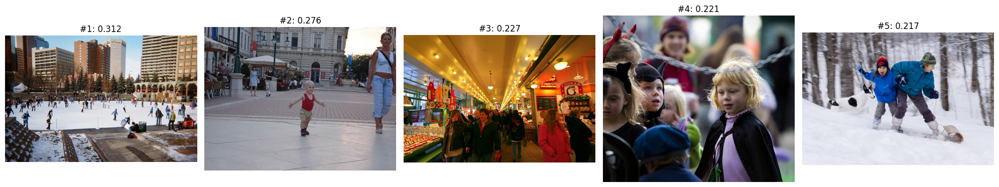


Фраза 5/5
Запрос: 'Little kid in blue coat and hat riding a tricycle .'
Обработка 100 изображений...

Поиск по запросу: 'Little kid in blue coat and hat riding a tricycle .'

Найдено топ-5 изображений:

1. Индекс: 20, Сходство: 0.3120, Путь: test_images\2428094795_d3a8f46046.jpg
2. Индекс: 54, Сходство: 0.2603, Путь: test_images\3211199368_ca78387f72.jpg
3. Индекс: 9, Сходство: 0.2559, Путь: test_images\191003283_992257f835.jpg
4. Индекс: 1, Сходство: 0.2410, Путь: test_images\1232148178_4f45cc3284.jpg
5. Индекс: 27, Сходство: 0.2393, Путь: test_images\2552438538_285a05b86c.jpg


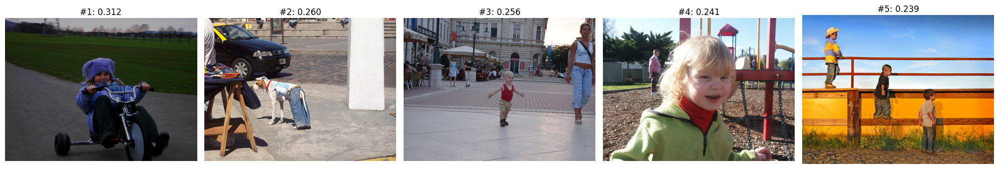


Обработка завершена. Всего фраз: 5
Успешно обработано: 5
Заблокировано: 0


In [ ]:
all_results = find_top_images_clip(
    text_description=random_sample,
    model=model,
    preprocess=preprocess,
    image_dir=IMAGE_DIR,
    top_k=5,
    device=device,
    show_images=True,
    enable_content_filter=False # Специально отключил что бы посмотреть как будет.
)


### Вывод

- Мы провели обучения нескольких моделей от baseline (LogisticRegression) до решений на базе мультимодальных и обычных полносвязных нейросетей.

- Решение на базе регрессии показали сомнительную эффективность , показав удовлетворительный результат только при первом текстовом запросе.

- Нейросети показали большую вариабельность при разных текстовых запросах , но в целом результат не сильно лучше baseline моделей.

- В свою очередь готовое решение на базе CLIP , продемонстрировало отличные результаты.

## Общий вывод

К нам обратился заказчик из сервиса “With Sense”* с просьбой разработать тестовый вариант модели поиска загруженных фото по текстовому описанию, вот чего удалось добиться :

- Мы загрузили поступившие нам как табличные так и графические данные. При первичном ознакомлении датасеты были готовы к обучению без предобработки.

- Датасеты содержали несколько способов оценки соответствия изображения текстовому описанию. Мы выполнили объединение и агрегацию оценок , что привело к формированию единого датасета.

- Так же для соблюдения юридических норм , нами были удалены из тренировочной выборки , фото содержащие детей. В конечном итоге нам удалось получить набор данных размерностью 5716 строк , содержащий уникальные оценки для описанных фото.

- При помощи таких готовых решений как ResNet50 и BERT , нами были извлечены эмбединги фото и текста для дальнейшей передачи в модели МО.

- На этапе обучения моделей нами были выбраны несколько направлений, а именно: в качестве baseline выступала LogisticRegression с постобработкой данных и без неё, а также полносвязные и мультимодальные нейронные сети. К сожалению эффективность такого подхода оказалась достаточно низкой.

- Так же нами было протестировано готовое решение в виде модели на базе CLIP , показавшей при визуальном анализе отличные результаты.

## Рекомендации

- Основной причиной низкой эффективности классических моделей, вероятно, является значительный дисбаланс классов в данных.


- Для улучшения результатов рекомендуется увеличить долю положительных примеров в обучающей выборке.


- На текущий момент решение на базе CLIP , готово к внедрению без дополнительного дообучения.